# <center>PRÁCTICA 1: APRENDIZAJE NO SUPERVISADO (DengAI)<center>

**Nombre y apellidos:** Carla Daniela Di Monno

**Usuario VIU:** cdimonno@student.universidadviu.com

---
# Resumen
---

## Contexto
---
El dengue es una enfermedad viral transmitida por mosquitos, especialmente común en regiones tropicales y subtropicales. Sus síntomas varían desde leves hasta graves, e incluso pueden ser mortales. La transmisión del dengue se ve influenciada por factores climáticos como la temperatura y las precipitaciones, lo que hace que el clima sea un factor determinante en su propagación.

Ante el cambio climático, se espera que la distribución geográfica del dengue se expanda, afectando a nuevas poblaciones. Para abordar este desafío, se ha creado la competencia DengAI. En esta competencia, el objetivo es desarrollar modelos capaces de predecir el número semanal de casos de dengue en San Juan (Puerto Rico) e Iquitos (Perú), utilizando datos climáticos y ambientales proporcionados por agencias gubernamentales de EE.UU. como los Centros para el Control y Prevención de Enfermedades (CDC) y la Administración Nacional Oceánica y Atmosférica (NOAA).

Al analizar estos datos, se busca comprender cómo variables como la temperatura, las precipitaciones y la vegetación influyen en los brotes de dengue. Esta información es crucial para mejorar la capacidad de predicción y, por lo tanto, optimizar la asignación de recursos en las iniciativas de salud pública destinadas a prevenir y controlar futuros brotes. Además, este enfoque contribuye a los esfuerzos globales para anticipar y mitigar pandemias.


## Objetivo
---
El objetivo de esta práctica es explorar los datos de la competencia DengAI mediante técnicas de minería de datos y aprendizaje no supervisado, en conjunto con la ingeniería de características. Se busca identificar patrones y características relevantes para mejorar la predicción de casos de dengue, incluyendo la selección de variables, la aplicación de clustering y la evaluación de nuevas variables.

## Fases experimentación y resultados obtenidos
---
Este trabajo se enfoca en explorar y analizar diversas metodologías de clustering en el ámbito del aprendizaje no supervisado, con el objetivo de agrupar objetos similares en conjuntos o clústeres. En particular, se aplicarán y compararán cuatro técnicas de clustering: **Clustering Jerárquico Aglomerativo, K-Means, DBSCAN y GMM (Expectation-Maximization)**, utilizando un conjunto de datos de entrenamiento previamente preprocesado.

El proceso se inicia con un análisis exhaustivo de los datos, incluyendo la minería de datos y el preprocesado. Se realiza un análisis inicial para comprender la estructura y características de los datos, seguido de filtros y transformaciones necesarias. Se lleva a cabo una estadística descriptiva inicial y se aborda el tratamiento de valores faltantes y outliers. Posteriormente, se realiza una ingeniería avanzada de características, creando
nuevas características a partir de las existentes e identificando aquellas más relevantes y eliminando las que no aportan valor a partir del clustering aplicado al dataset traspuesto. Luego, se aplican los algoritmos de clustering mencionados al dataset preprocesado para identificar patrones, agrupaciones y relaciones en los datos. Finalmente, se extraen conclusiones significativas que resumen los hallazgos obtenidos del análisis de datos y los algoritmos de clustering aplicados. Este enfoque integral nos permitirá obtener una comprensión más profunda de los datos y generar conocimiento relevante para abordar el desafío planteado en este trabajo: **"DengAI: Predicting Disease Spread"**.

---
# Inicialización
---

In [ ]:
# Imports generales
import pandas as pd
import numpy as np
import io
import math
from google.colab import files

# Visualización de datos / Gráficos
import seaborn as sns
import matplotlib.pyplot as plt
# Preprocesamiento
from sklearn.preprocessing import MinMaxScaler, StandardScaler
# Preprocesamiento / Modelado
from sklearn.decomposition import PCA
from scipy import cluster
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import DBSCAN, AgglomerativeClustering, KMeans
from sklearn.neighbors import NearestNeighbors
from sklearn import metrics
from sklearn.metrics import silhouette_score
from sklearn.mixture import GaussianMixture

seed = 42  # Semilla aleatoria arbitraria y constante a incluir en los algoritmos estocásticos para que los experimentos sean siempre reproducibles por el profesor.
# OJO: En los experimentos estocásticos que requieran varias iteraciones con distintas semillas, podéis incorporarla como seed+1, seed+2, etc.

def upload_files (index_fields=None):
  uploaded = files.upload()
  for fn in uploaded.keys():
    print('User uploaded file "{name}" with length {length} bytes'.format(
        name=fn, length=len(uploaded[fn])))
    df = pd.read_csv(io.StringIO(uploaded[fn].decode('utf-8')), index_col = index_fields)
    return df

In [ ]:
# Subir el conjunto de entrenamiento sin variable objetivo (dengue_features_train.csv)
train = upload_files()
print(train.shape)
train.head()

Saving dengue_features_train (1).csv to dengue_features_train (1).csv
User uploaded file "dengue_features_train (1).csv" with length 287139 bytes
(1456, 24)


,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,sj,1990,18,1990-04-30,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,...,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0
1,sj,1990,19,1990-05-07,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,...,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6
2,sj,1990,20,1990-05-14,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,...,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4
3,sj,1990,21,1990-05-21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,...,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0
4,sj,1990,22,1990-05-28,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,...,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8


In [ ]:
train.tail()

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
1451,iq,2010,21,2010-05-28,0.342750,0.318900,0.256343,0.292514,55.30,299.334286,...,45.00,88.765714,55.30,18.485714,9.800000,28.633333,11.933333,35.4,22.4,27.0
1452,iq,2010,22,2010-06-04,0.160157,0.160371,0.136043,0.225657,86.47,298.330000,...,207.10,91.600000,86.47,18.070000,7.471429,27.433333,10.500000,34.7,21.7,36.6
1453,iq,2010,23,2010-06-11,0.247057,0.146057,0.250357,0.233714,58.94,296.598571,...,50.60,94.280000,58.94,17.008571,7.500000,24.400000,6.900000,32.2,19.2,7.4
1454,iq,2010,24,2010-06-18,0.333914,0.245771,0.278886,0.325486,59.67,296.345714,...,62.33,94.660000,59.67,16.815714,7.871429,25.433333,8.733333,31.2,21.0,16.0
1455,iq,2010,25,2010-06-25,0.298186,0.232971,0.274214,0.315757,63.22,298.097143,...,36.90,89.082857,63.22,17.355714,11.014286,27.475000,9.900000,33.7,22.2,20.4


---
# Exploración
---

En esta sección primero se busca tener una idea general de cómo son los datos y cómo están distribuidos, etc., realizando un análisis exploratorio de los datos que consiste en obtener el análisis estadístico descriptivo de los datos y visualizar el comportamiento y relaciones de las variables mediante distintos gráficos. Para ello se implementa fragmentos de código que he utilizado previamente en mis prácticas de Minería de Datos y en algunos casos el asistente Gemini(IA) del Google Colab.

## Análisis Exploratorio de Datos (EDA)
---

### **Dataset completo**

In [ ]:
# Obtener información sobre la BBDD dengue_features_train (tamaño, características, tipos de datos, etc.)
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 24 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   object 
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   week_start_date                        1456 non-null   object 
 4   ndvi_ne                                1262 non-null   float64
 5   ndvi_nw                                1404 non-null   float64
 6   ndvi_se                                1434 non-null   float64
 7   ndvi_sw                                1434 non-null   float64
 8   precipitation_amt_mm                   1443 non-null   float64
 9   reanalysis_air_temp_k                  1446 non-null   float64
 10  reanalysis_avg_temp_k                  1446 non-null   float64
 11  rean

El datset original de entrenamiento **dengue_features_train.csv** contiene 1456 instancias y 24 características.
En este enlace se puede ver una descripción de qué significan las características del dataset: https://www.drivendata.org/competitions/44/dengai-predicting-disease-spread/page/82/.

Según se observa en el enlace, las características brindan una escala de tiempo con la fecha de las mediciones, temperaturas, rango de temperaturas, precipitación, humedad relativa, humedad específica y el índice *'ndvi'* que se relaciona con información sobre la densidad de vegetación en los puntos cardinales de las ciudades. Específicamente *'ndvi'*  es el Índice de Vegetación de Diferencia Normalizada, mide la cantidad y salud de la vegetación en una superficie, basado en la reflectancia de la luz en diferentes longitudes de onda. Toma valores entre -1 y 1, donde valores más altos indican una vegetación más saludable y valores bajos o negativos pueden indicar estrés vegetal o ausencia de vegetación (ref.:[cursosteledetección](https://www.cursosteledeteccion.com/ndvi-que-es-y-para-que-sirve/)).

De la información obtenida del dataframe vemos que las 4 primeras variables no tiene valores faltantes y que las columnas *'city' y 'week_start_date'* son de tipo objeto, mientras que el resto son numéricas. Siendo solo *'year' y  'weekofyear'* enteras y el resto reales, representadas en punto flotante.

#### **Estadísticas generales iniciales**

In [ ]:
# Estadística descriptiva de características numéricas climatológicas y ambientales (no nulos, media, desviación estándar, mínimo, percentiles, máximo)
train.describe(include=['float64'])

,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
count,1262.000000,1404.000000,1434.000000,1434.000000,1443.000000,1446.000000,1446.000000,1446.000000,1446.000000,1446.000000,1446.000000,1446.000000,1443.000000,1446.000000,1446.000000,1413.000000,1413.000000,1436.000000,1442.000000,1434.000000
mean,0.142294,0.130553,0.203783,0.202305,45.760388,298.701852,299.225578,295.246356,303.427109,295.719156,40.151819,82.161959,45.760388,16.746427,4.903754,27.185783,8.059328,32.452437,22.102150,39.326360
std,0.140531,0.119999,0.073860,0.083903,43.715537,1.362420,1.261715,1.527810,3.234601,2.565364,43.434399,7.153897,43.715537,1.542494,3.546445,1.292347,2.128568,1.959318,1.574066,47.455314
min,-0.406250,-0.456100,-0.015533,-0.063457,0.000000,294.635714,294.892857,289.642857,297.800000,286.900000,0.000000,57.787143,0.000000,11.715714,1.357143,21.400000,4.528571,26.700000,14.700000,0.000000
25%,0.044950,0.049217,0.155087,0.144209,9.800000,297.658929,298.257143,294.118929,301.000000,293.900000,13.055000,77.177143,9.800000,15.557143,2.328571,26.300000,6.514286,31.100000,21.100000,8.700000
50%,0.128817,0.121429,0.196050,0.189450,38.340000,298.646429,299.289286,295.640714,302.400000,296.200000,27.245000,80.301429,38.340000,17.087143,2.857143,27.414286,7.300000,32.800000,22.200000,23.850000
75%,0.248483,0.216600,0.248846,0.246982,70.235000,299.833571,300.207143,296.460000,305.500000,297.900000,52.200000,86.357857,70.235000,17.978214,7.625000,28.157143,9.566667,33.900000,23.300000,53.900000
max,0.508357,0.454429,0.538314,0.546017,390.600000,302.200000,302.928571,298.450000,314.000000,299.900000,570.500000,98.610000,390.600000,20.461429,16.028571,30.800000,15.800000,42.200000,25.600000,543.300000


A primera vista las estadísticas del dataset "parecieran estar bien", entonces para tener un mejor entendimiento de los datos nos conviene visualizarlos mediante gráficos.

#### **Diagrama de barras variables categóricas**

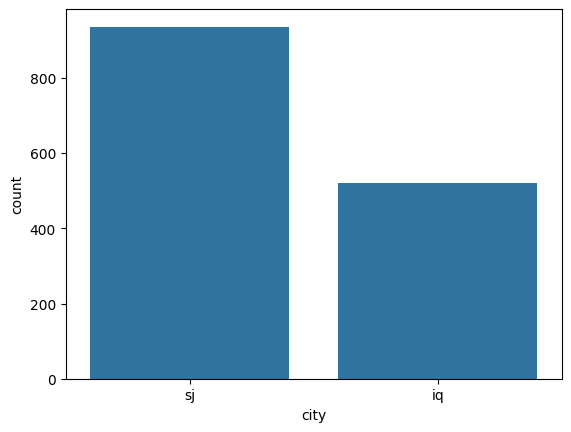

In [ ]:
# Diagrama de barras de la variable categórica 'city'
sns.countplot(data=train, x='city')
plt.show()

Del gráfico de barras anterior se observa que la variable *'city'* está desbalanceada. Es decir, tenemos más datos de prueba para la ciudad de San Juan que de Iquitos. Esto puede afectar la calidad de los modelos predictivos y su precisión, ya que puede no predecir correctamente los datos menos representados si consideramos usar todo en conjunto. Pero, ¿en qué se diferencian las ciudades de San Juan e Iquitos? *Es muy probable que el comportamiento de la enfermedad en ambas ciudades sea distinto, debido a diferencias climáticas y ambientales, como por ejemplo clima más seco y clima húmedo, por lo tanto más adelante sería conveniente dividir el dataset*.

#### **Transformación variable categórica a numérica**

La variable categórica *'city'* registra la ciudad donde se tomaron los datos. Dado que el conjunto de datos solo incluye dos ciudades, San Juan e Iquitos, se asignará el valor 0 a San Juan y el valor 1 a la otra ciudad, Iquitos, para poder realizar cálculos.

In [ ]:
# Mapear variable categórica 'city' a numérica
train['city_mapped'] = train['city'].map({'sj': 0, 'iq': 1})
print(train[['city', 'city_mapped']])

     city  city_mapped
0      sj            0
1      sj            0
2      sj            0
3      sj            0
4      sj            0
...   ...          ...
1451   iq            1
1452   iq            1
1453   iq            1
1454   iq            1
1455   iq            1

[1456 rows x 2 columns]


In [ ]:
# También podría haber binarizado la variable categórica city con la siguiente función
#from sklearn import preprocessing
#lb = preprocessing.LabelBinarizer()
#train['city_bin'] = lb.fit_transform(train['city'])
train['city'] = train['city_mapped']
train.drop('city_mapped', axis=1, inplace=True)
train.head()

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,0,1990,18,1990-04-30,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,...,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0
1,0,1990,19,1990-05-07,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,...,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6
2,0,1990,20,1990-05-14,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,...,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4
3,0,1990,21,1990-05-21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,...,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0
4,0,1990,22,1990-05-28,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,...,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8


Esta transformación de la variable categórica *'city'* en numérica correspondería realizarlo en la subsección de transformación, pero lo realizo en este punto porque me aporta una ventaja para realizar la gráfica de dispersión 2 a 2 con pairplot en breve.

#### **Análisis univariante (histogramas/percentiles)**

La visualización de histogramas permite observar la distribución de las variables en el conjunto de datos y detectar posibles sesgos, outliers o patrones interesantes para explorar en el análisis posterior.

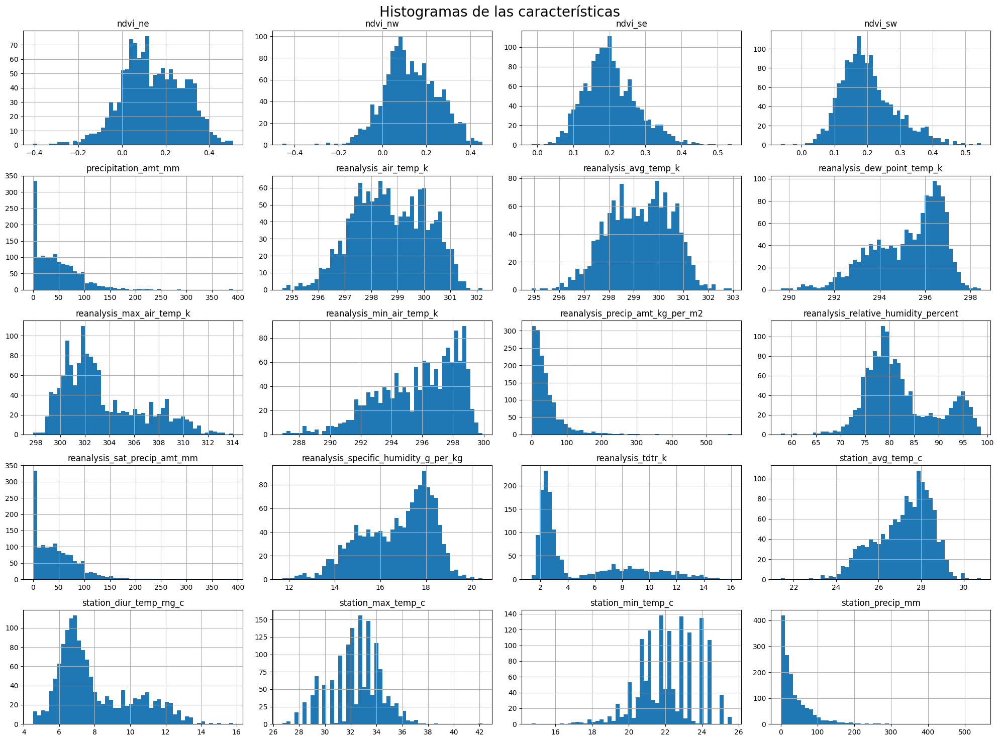

In [ ]:
# Histogramas de las variables numéricas
train.drop(['city', 'year', 'weekofyear'], axis=1).hist(figsize=(20,15), bins=50)
plt.suptitle('Histogramas de las características', fontsize = 20)
plt.tight_layout()
plt.show()

De los histogramas anteriores, se observa que algunas variables ambientales relacionadas con la vegetación, como *'ndvi_ne', 'ndvi_nw', 'ndvi_se' y 'ndvi_sw'*, siguen distribuciones más o menos simétricas, similares a la forma de una campana de Gauss, lo que sugiere una distribución normal o ligeramente sesgada. Por otro lado, variables como *'precipitation_amt_mm', 'reanalysis_precip_amt_kg_per_m2', y 'station_precip_mm'* muestran distribuciones asimétricas, sesgadas hacia la derecha, lo que indica que los eventos extremos de lluvia son menos comunes pero pueden tener un impacto significativo.
Las variables relacionadas con la temperatura, como *'reanalysis_avg_temp_k' y 'station_avg_temp_c'*, tienden a tener distribuciones más uniformes con algún grado de sesgo, lo que es habitual en datos de temperatura donde se observa un rango estable alrededor de la media, con variaciones dependientes del clima local. Mientras otras variables de temperatura, como *'station_max_temp_c'*, presentan un rango más amplio en comparación con *'reanalysis_tdtr_k'*, reflejando diferentes características de medición climática.

*Es importante señalar que las variables de temperatura están medidas en distintas escalas: Celsius en algunos casos y Kelvin en otros. Esta diferenicia de unidades debe ser considerada en el análisis y también requiere un posterior escalado y/o normalizado*.

Los patrones de distribución observados serán importantes para la selección de características y el preprocesamiento de los datos para el posterior modelado predictivo.

En los histogramas se han detectado posibles outliers, para una comprensión más profunda de estos se realizan los diagramas de caja o boxplot de todas las variables numéricas, que muestran la distribución de los datos a través de cuartiles y percentiles.

La caja representa el rango intercuartílico (IQR), que contiene el 50% central de los datos (entre el percentil 25 y 75). Los bigotes se extienden hasta los valores mínimo y máximo dentro de un rango definido (generalmente 1.5 veces el IQR desde la caja). Los puntos fuera de los bigotes se consideran valores atípicos/outliers.

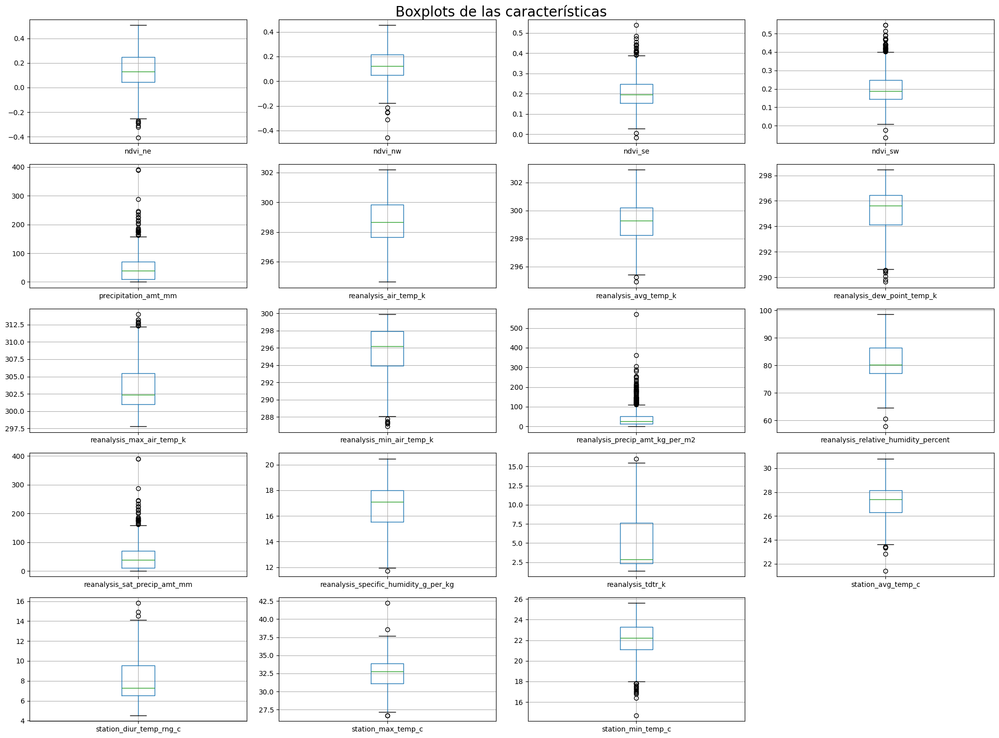

In [ ]:
# Diagramas de caja (boxplot) de las variables numéricas
nc = train.columns[4:23].tolist()

plt.figure(figsize=[20, 15])
plt.suptitle('Boxplots de las características', fontsize = 20)
for c in range(len(nc)):
    plt.subplot(math.ceil(len(nc)/4), 4, c+1)
    train.boxplot(nc[c])
plt.tight_layout()
plt.show()

Los outliers o valores atípicos son los que se observan fuera de los bigotes de las respectivas cajas de cada variable (1.5 veces el IQR desde Q1 y Q3).
Los boxplots anteriores muestran que las variables relacionadas con la vegetación *'ndvi_xx'* presentan distribuciones simétricas y estables, con pocos outliers. Las variables de precipitación como *'precipitation_amt_mm' y 'reanalysis_precip_amt_kg_per_m2'* tienen distribuciones sesgadas hacia valores bajos, con numerosos valores atípicos en el extremo superior, lo que indica eventos de precipitación extrema. Las variables de temperatura, tanto en Celsius como Kelvin, presentan distribuciones más compactas, con pocos outliers, lo que refleja estabilidad en las condiciones de temperatura. Las variables de humedad muestran un comportamiento similar, con valores concentrados y algunos outliers que podrían señalar eventos de baja humedad.
Las variables de precipitación y algunas de temperatura muestran mayor cantidad de valores atípicos, lo que sugiere que deben ser tratados cuidadosamente más adelante.

#### **Análisis bivariante (diagramas de dispersión 2 a 2)**

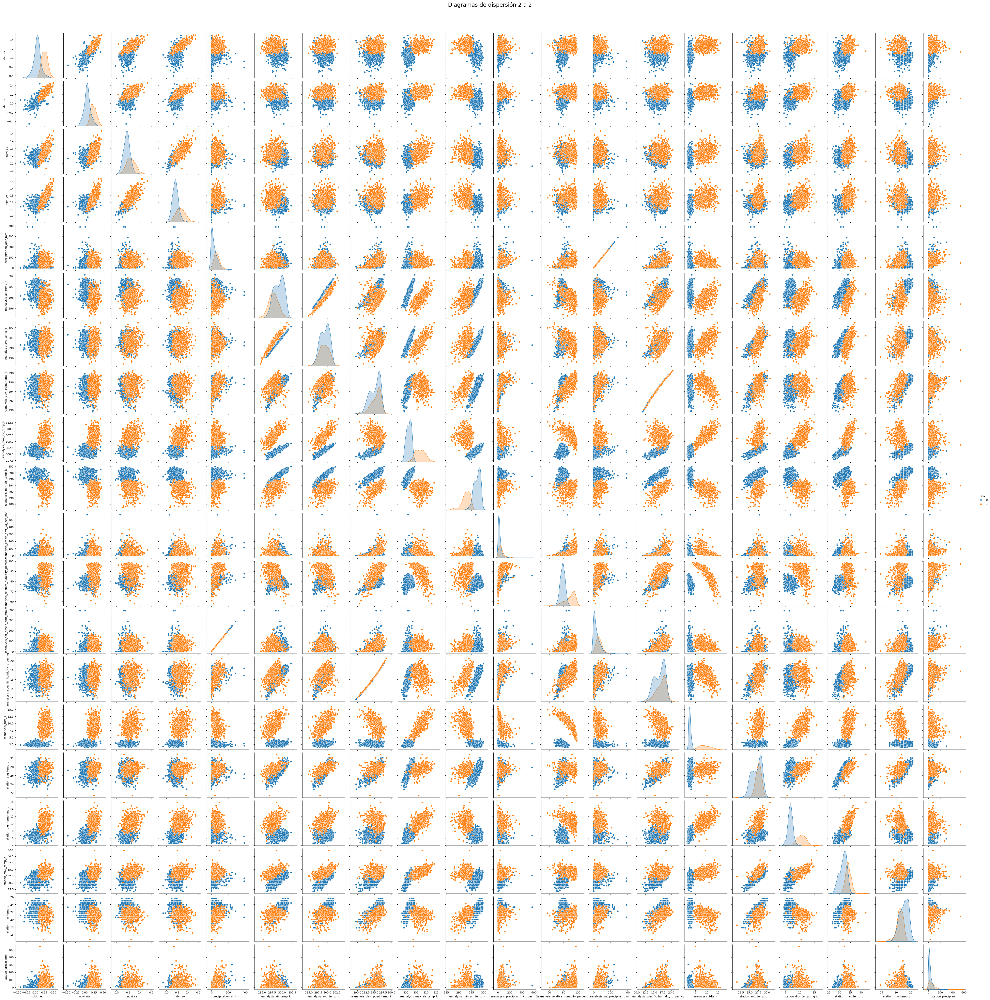

In [ ]:
# Visualización de los gráficos de dispersión del dataset tratado con pairplot
sns.pairplot(data=train.drop(['year', 'weekofyear'], axis=1), hue='city')
plt.suptitle('Diagramas de dispersión 2 a 2', fontsize = 20, y=1.02)
plt.show()

Debido a la complejidad del conjunto de datos y la gran cantidad de variables que lo componen, resulta difícil identificar relaciones directas entre ellas. No obstante, un análisis visual revela pares de variables con patrones prácticamente lineales evidentes, aunque la mayoría presenta una distribución más dispersa.

Para una mejor visualización se va a dividir el pairplot considerando el tipo de variables: temperatura, precipitación/humedad y vegetación.

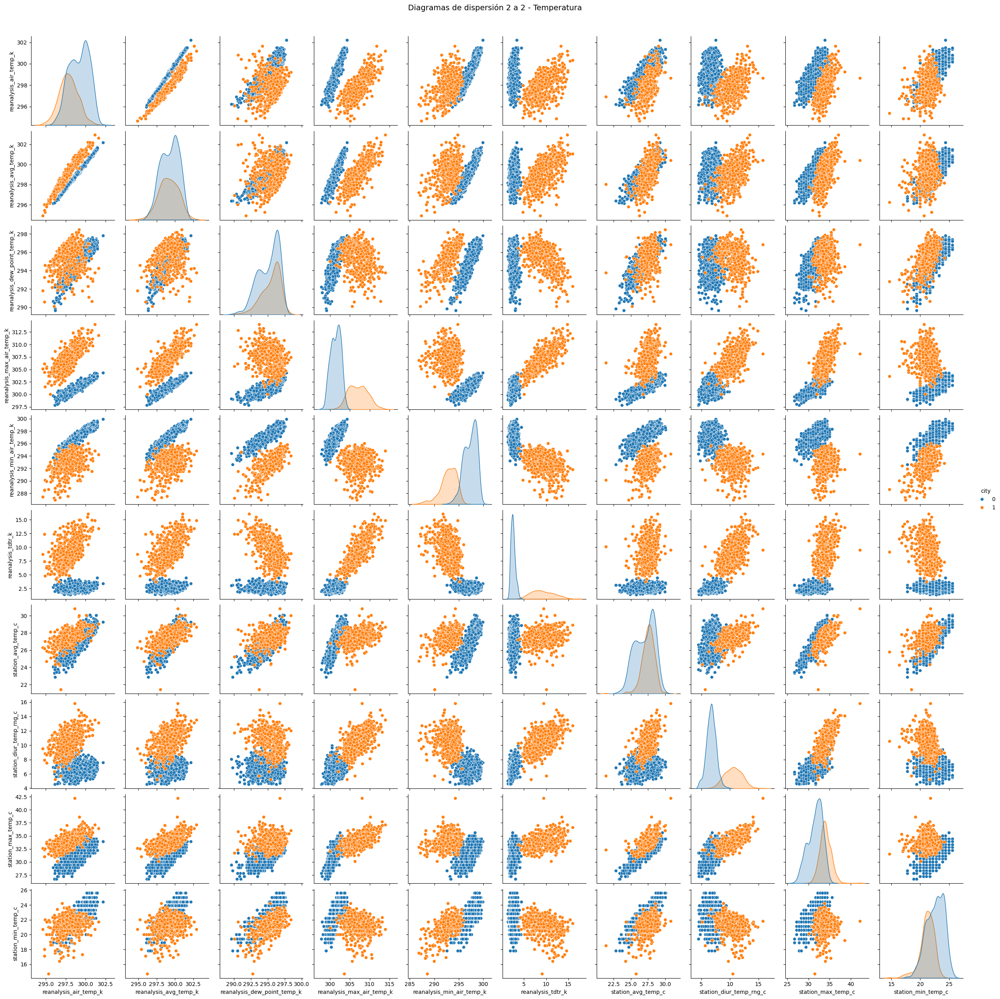

In [ ]:
sns.pairplot(train[['city','reanalysis_air_temp_k','reanalysis_avg_temp_k', 'reanalysis_dew_point_temp_k','reanalysis_max_air_temp_k', 'reanalysis_min_air_temp_k', 'reanalysis_tdtr_k',
       'station_avg_temp_c', 'station_diur_temp_rng_c', 'station_max_temp_c', 'station_min_temp_c']], hue='city')
plt.suptitle('Diagramas de dispersión 2 a 2 - Temperatura', fontsize = 14, y=1.02)
plt.show()

Se observa que las variables *'reanalysis_air_temp_k' y 'reanalysis_avg_temp_k'* están correlacionadas. En cuanto al resto de las variables se observan distribuciones bimodales en la mayoría de los casos y con sesgo.

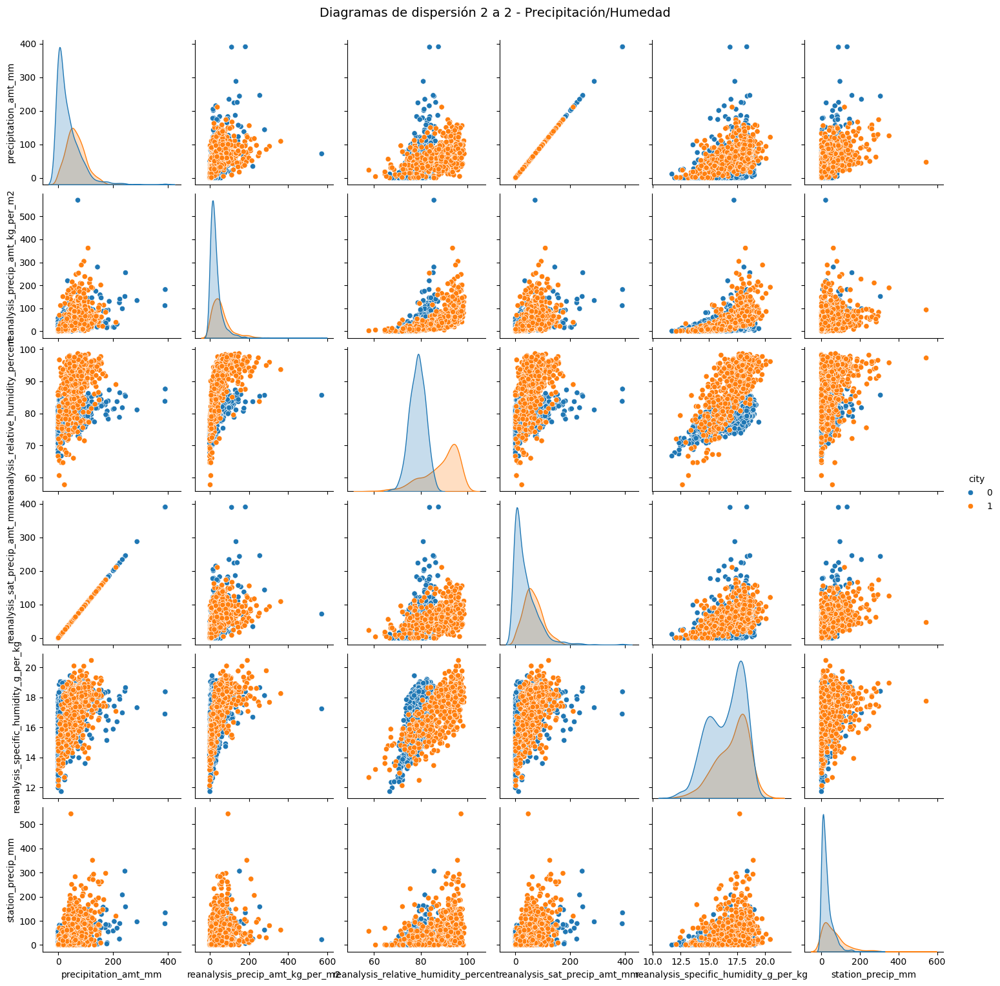

In [ ]:
sns.pairplot(train[['city','precipitation_amt_mm', 'reanalysis_precip_amt_kg_per_m2', 'reanalysis_relative_humidity_percent', 'reanalysis_sat_precip_amt_mm',
                    'reanalysis_specific_humidity_g_per_kg', 'station_precip_mm']], hue='city')
plt.suptitle('Diagramas de dispersión 2 a 2 - Precipitación/Humedad', fontsize = 14, y=1.02)
plt.show()

Se observa que las variables *'reanalysis_sat_precip_amt_mm' y 'precipitation_amt_mm'* están claramente correlacionadas. En cuanto al resto de las variables se observan distribuciones con un alto sesgo.

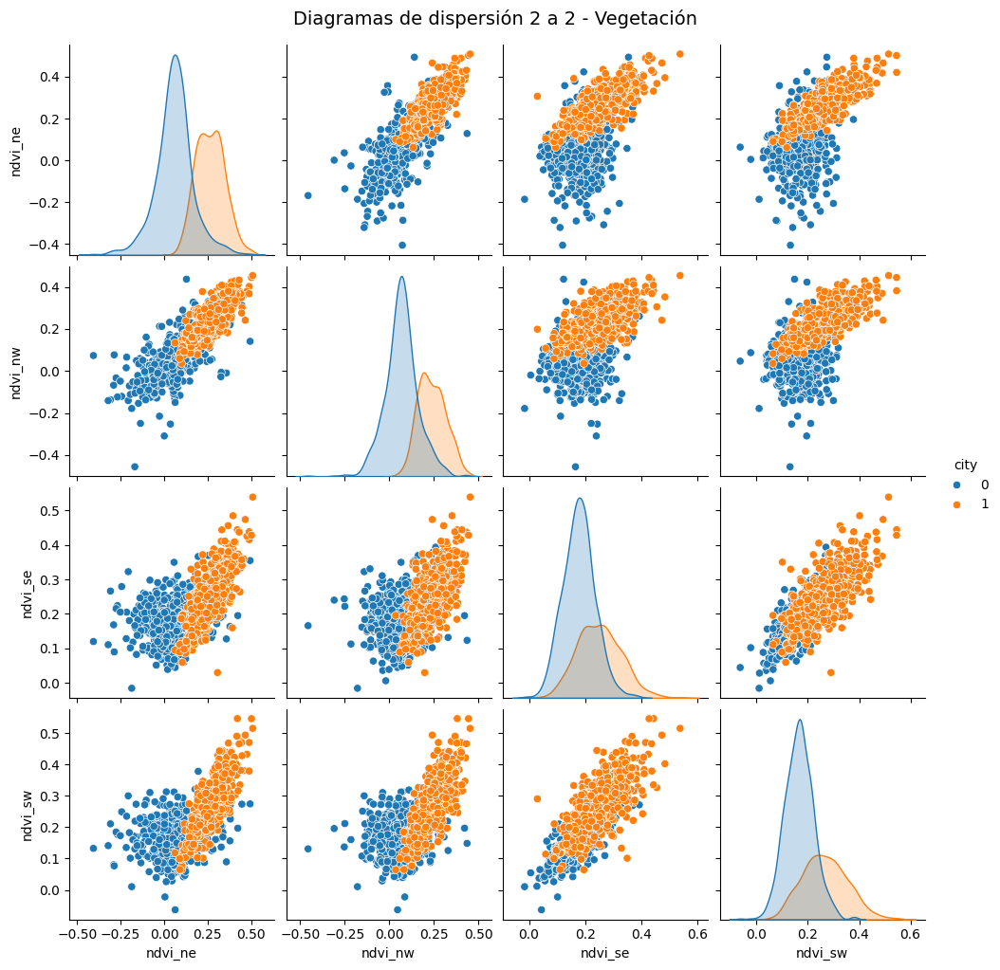

In [ ]:
sns.pairplot(train[['city','ndvi_ne', 'ndvi_nw', 'ndvi_se', 'ndvi_sw']], hue='city')
plt.suptitle('Diagramas de dispersión 2 a 2 - Vegetación', fontsize = 14, y=1.02)
plt.show()

Los resultados obtenidos para Vegetación revelan una clara correlación entre las variables *'ndvi'*, aunque también se observa cierta variabilidad en los datos. Esto lejos de ser un inconveniente, convierte a las variables *'ndvi'* en un elemento de gran interés para el análisis, ya que puede aportar información valiosa sobre la dinámica de la vegetación en la proliferación de los mosquitos y casos de dengue.

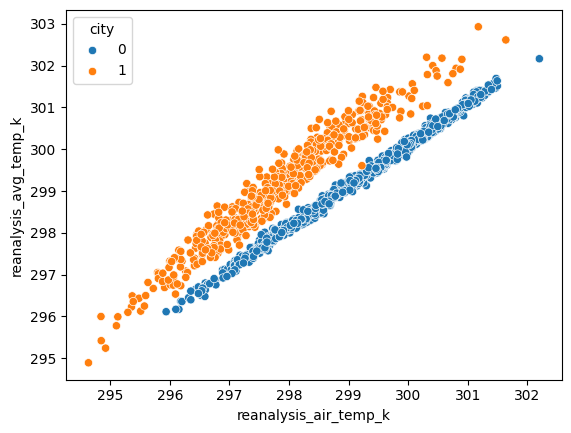

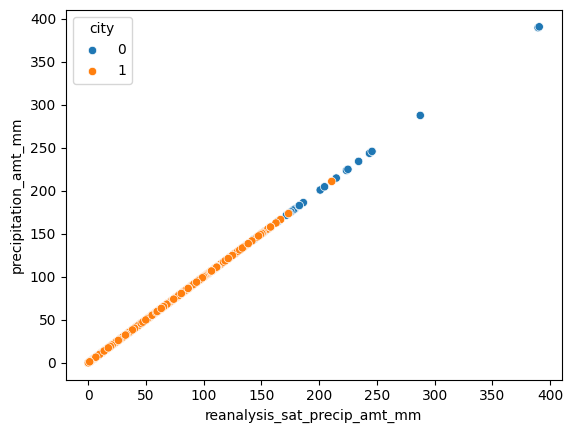

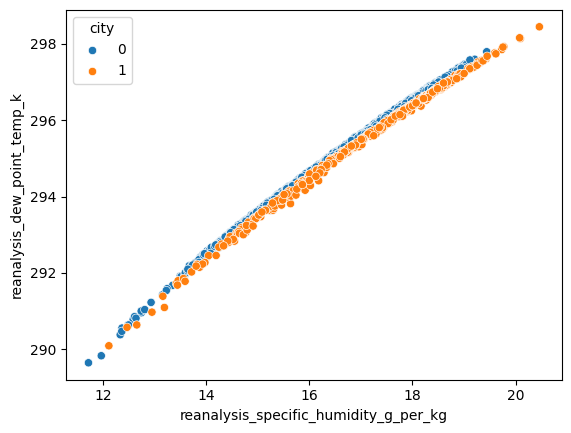

In [ ]:
# Visualizo en detalle los gráficos de dispersión de que aquellas variables que tienen una relación evidente
sns.scatterplot(data=train, x='reanalysis_air_temp_k', y='reanalysis_avg_temp_k', hue='city')
plt.show()

sns.scatterplot(data=train, x='reanalysis_sat_precip_amt_mm', y='precipitation_amt_mm', hue='city')
plt.show()

sns.scatterplot(data=train, x='reanalysis_specific_humidity_g_per_kg', y='reanalysis_dew_point_temp_k', hue='city')
plt.show()

#### **Correlaciones de características**

Una vez explorado el comportamiento de las variables y las posibles relaciones entre ellas, se utiliza la matriz de correlación para comprender mejor las mismas, con el objetivo de seleccionar las variables más relevantes y reducir la dimensionalidad de los datos.

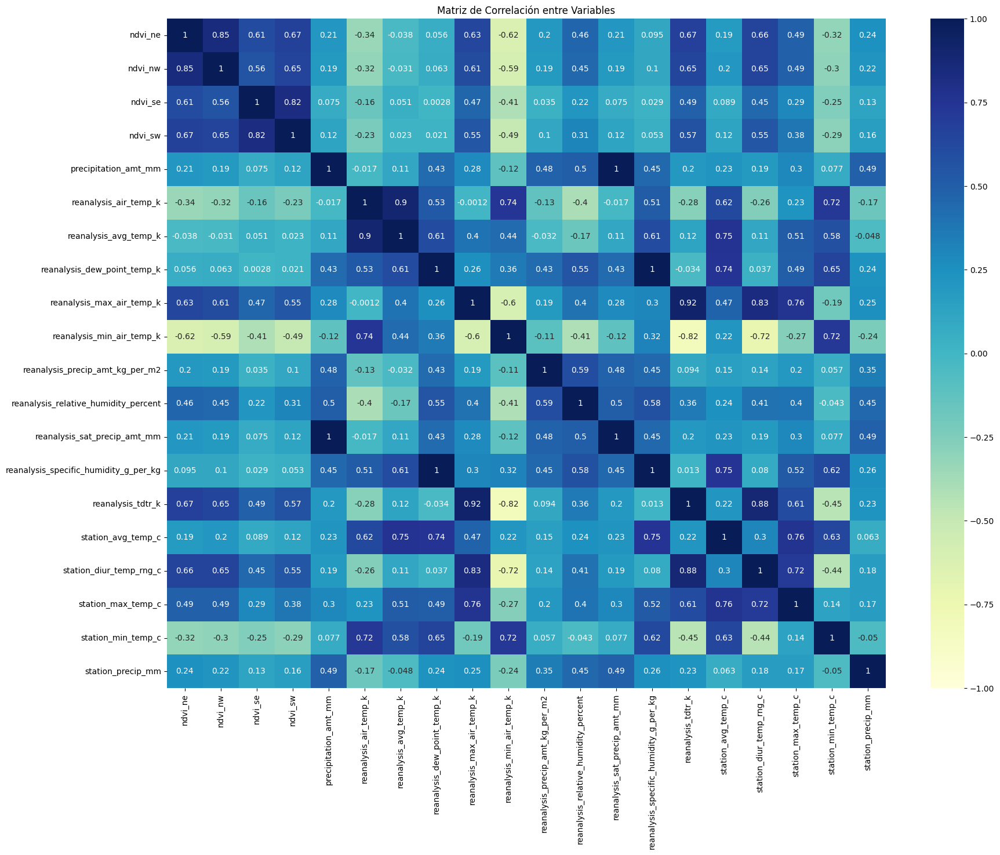

In [ ]:
# Visualizo la matriz de correlación
numeric_data = train.select_dtypes(include=['float64'])
plt.figure(figsize=(20, 15))
sns.heatmap(numeric_data.corr(), annot=True, cmap='YlGnBu', vmin=-1, vmax=1)
plt.title('Matriz de Correlación entre Variables')
plt.show()

Se ven indicios de alta correlación entre varias variables del dataset original, con lo cual al utilizarlas introduciríamos problemas al modelo que seleccionaremos luego. Por ejemplo, en consonancia con el análisis bivariante, *'reanalysis_sat_precip_amt_mm'* tiene una correlación de 1 con *'precipitation_amt_mm'* lo que indica que están representando lo mismo. Esto también sucede con *'reanalysis_specific_humidity_g_per_k'* con *'reanalysis_dew_point_temp_k'*, aunque tienen distintas magnitudes. En estos casos podemos quedarnos con una sola de estas variables, por lo tanto **eliminaremos las variables: 'precipitation_amt_mm' y 'reanalysis_dew_point_temp_k'**.

Las variables relacionadas con el índice de vegetación *'ndvi'* muestran una alta correlación entre sí, lo que indica que están capturando información similar sobre la cobertura vegetal. Sin embargo, como ninguna supera 0.9 se conservarán todas.

Las variables relacionadas con la precipitación, temperatura y humedad, muestran en general una alta correlación entre sí, lo que es esperable dado que estas variables están estrechamente relacionadas en los fenómenos climáticos.

También hay muchas correlaciones débiles o casi nulas, lo que indica que algunas variables pueden ser independientes o tener poca influencia en otras.




In [ ]:
train.drop(['precipitation_amt_mm', 'reanalysis_dew_point_temp_k'], axis = 1, inplace = True)

In [ ]:
train.shape

(1456, 22)

#### **Gráficas de evolución temporal**

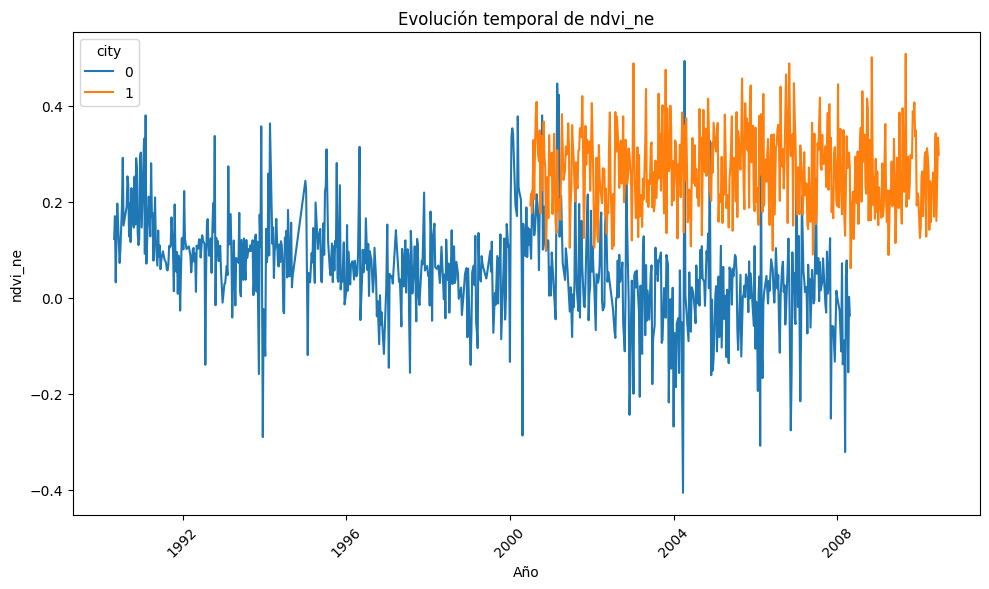

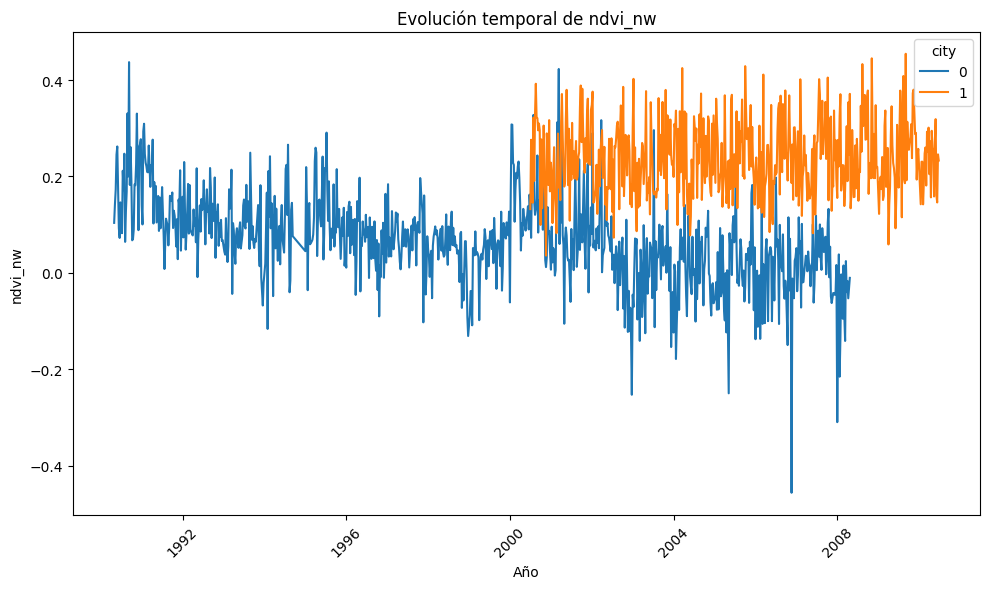

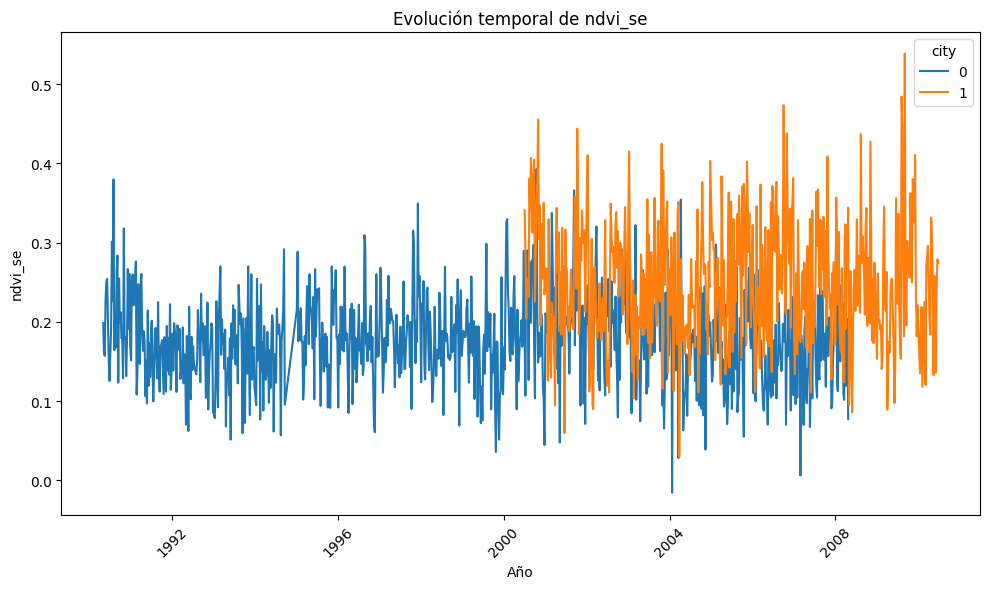

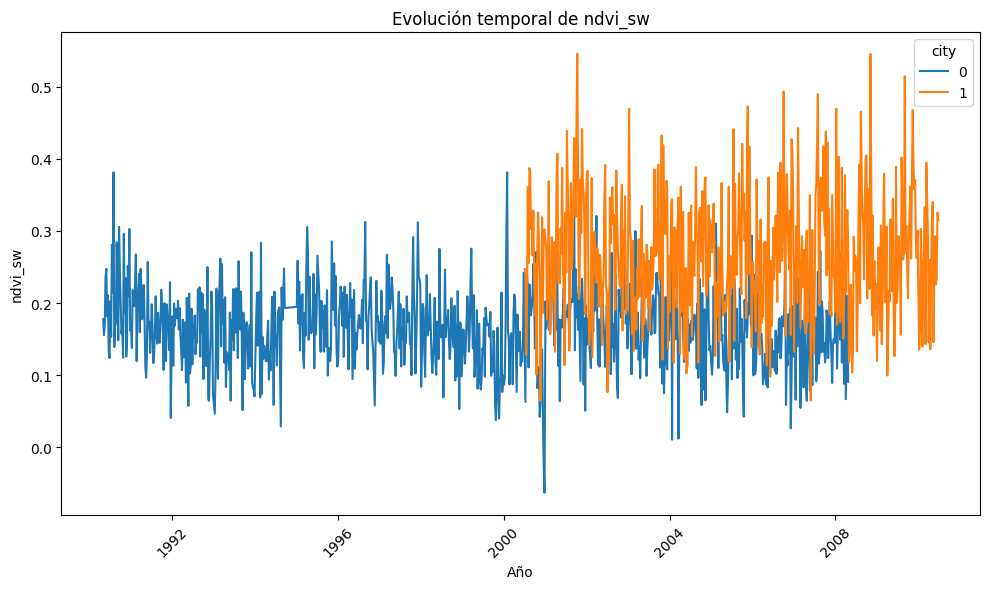

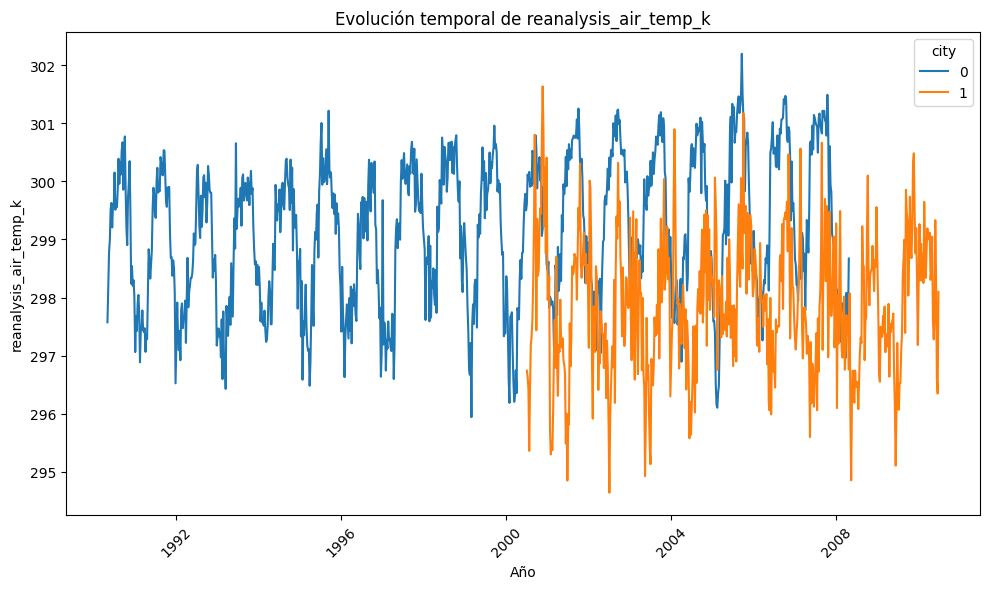

...

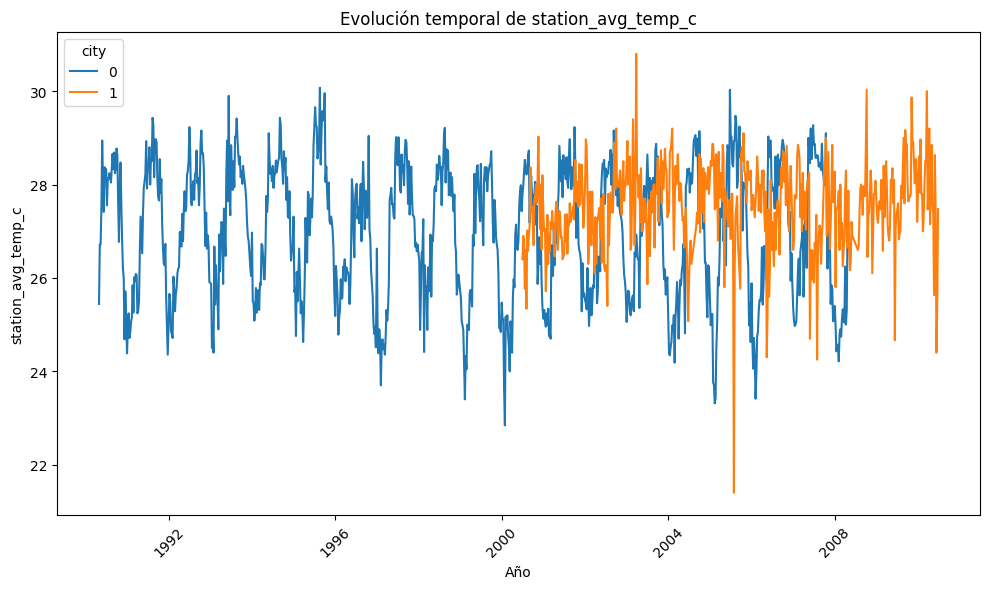

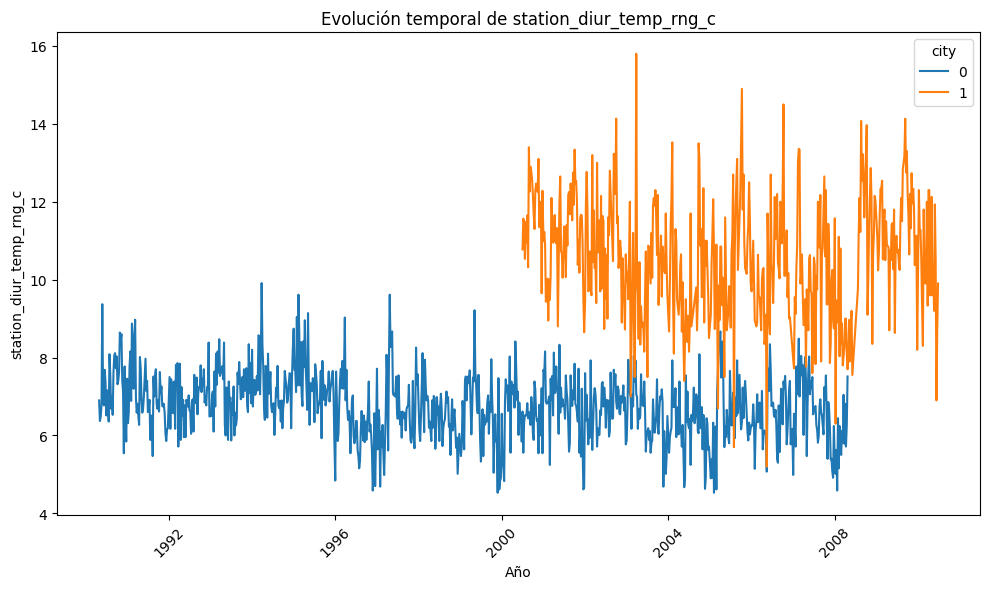

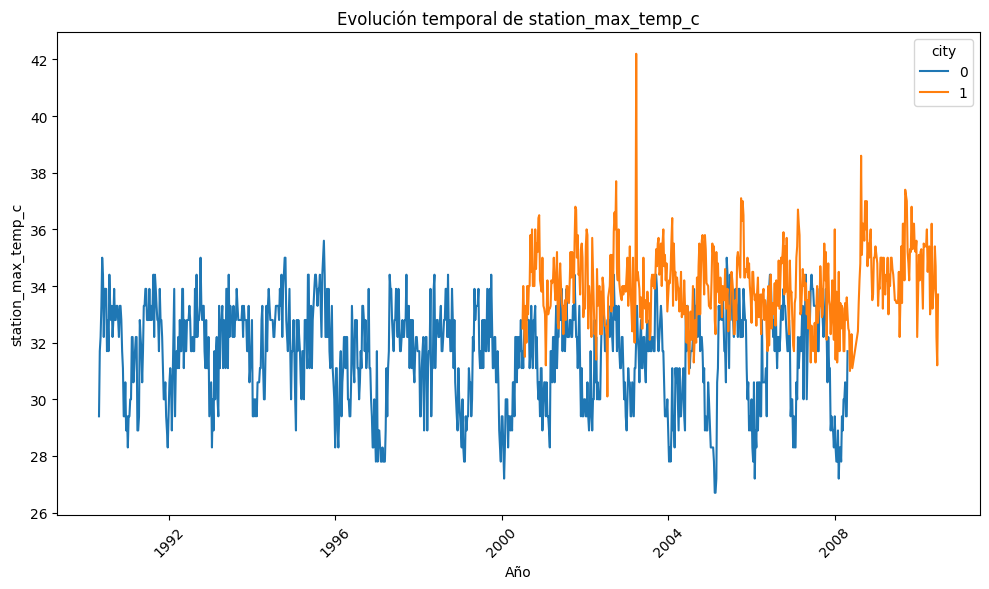

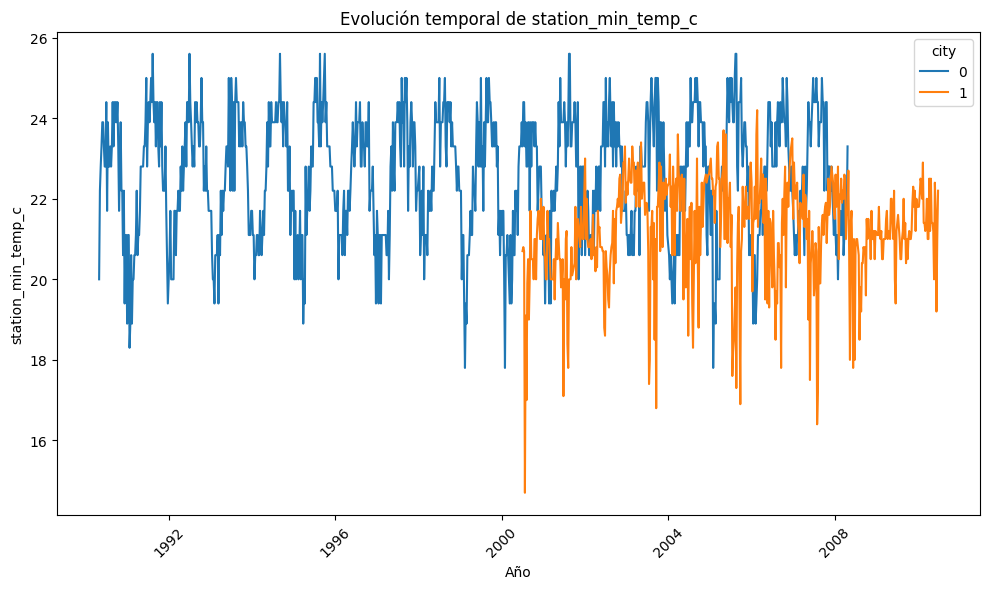

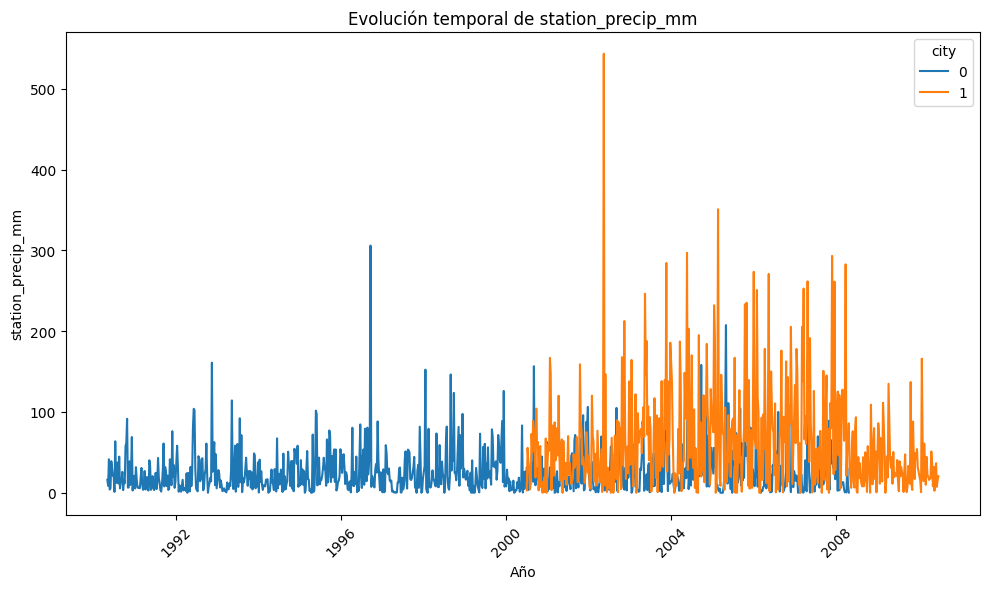

In [ ]:
# Gráficas de evolución temporal de las características con el tiempo en años
train['week_start_date'] = pd.to_datetime(train['week_start_date'])

for col in train.columns[4:]:
    plt.figure(figsize=(10, 6))
    sns.lineplot(x='week_start_date', y=col, data=train, hue='city')
    plt.title(f'Evolución temporal de {col}')
    plt.xlabel('Año')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


En estos últimos gráficos de evolución de características con el tiempo se refuerza la idea de que podría ser conveniente separar los datos de la ciudad de San Juan e Iquitos, debido a los distintos comportamientos y el intervalo de tiempo sobre el cuál se recogieron los datos.

Por otro lado, los gráficos de *'ndvi'* muestran diferencias en las dinámicas de vegetación de ambas ciudades, ya que San Juan pareciera tener un compartamiento más constante mientras Iquitos presenta mayor variabilidad. En cuanto a las gráficas de temperatura, se muestran comportamientos cíclicos anuales, algo similar sucede con las precipitaciones y la humedad, y también se puede ver que la amplitud térmica en Iquitos es mayor que en San Juan (comparando gráficas de máxima y mínima temperaturas).

Ahora, para ver el compartamiento de las variables con más detalle se analiza la evolución temporal de las características durante un año. En este caso, se seleccionó 2004 para tener datos de ambas ciudades.



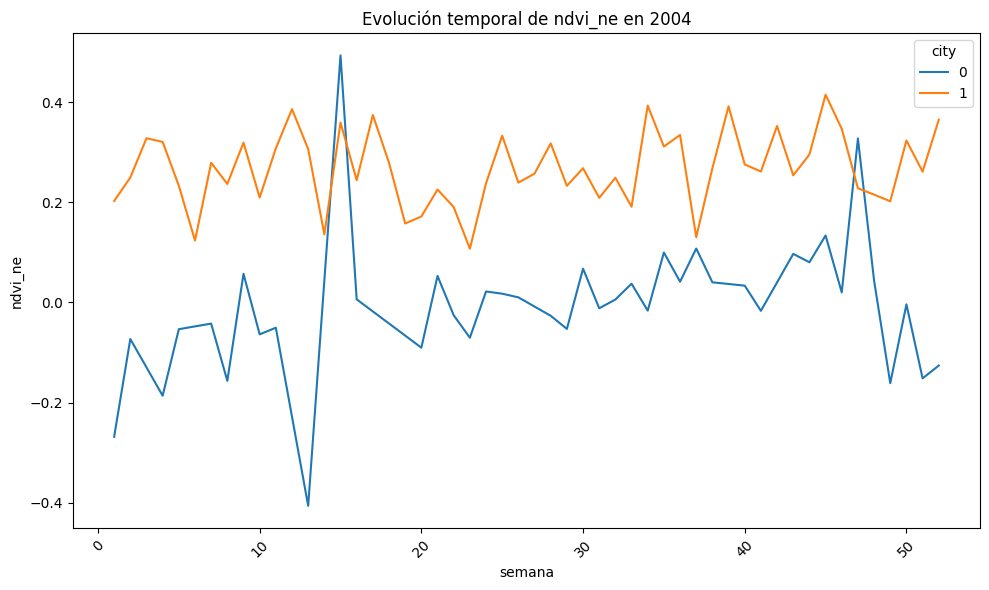

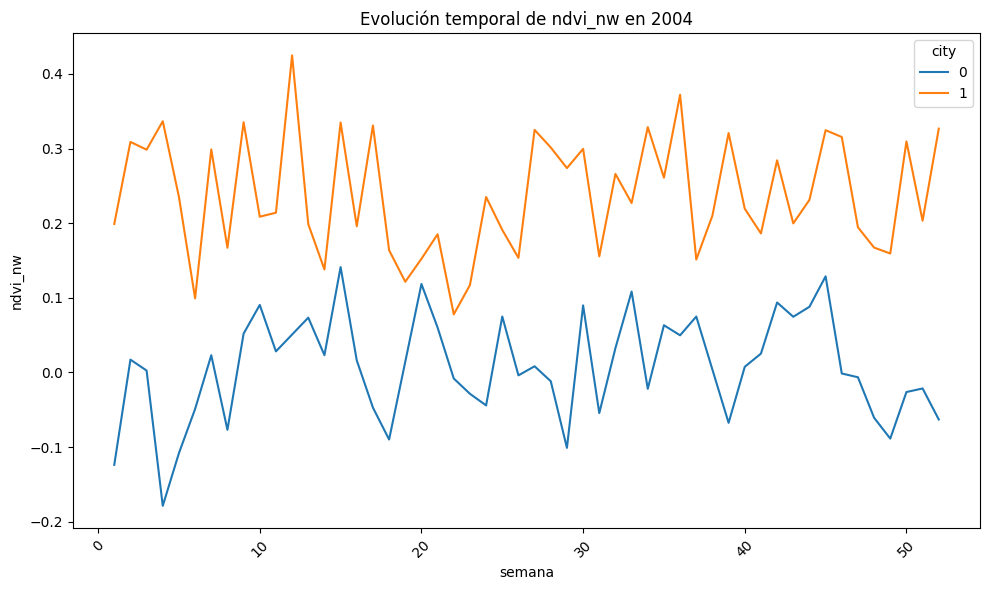

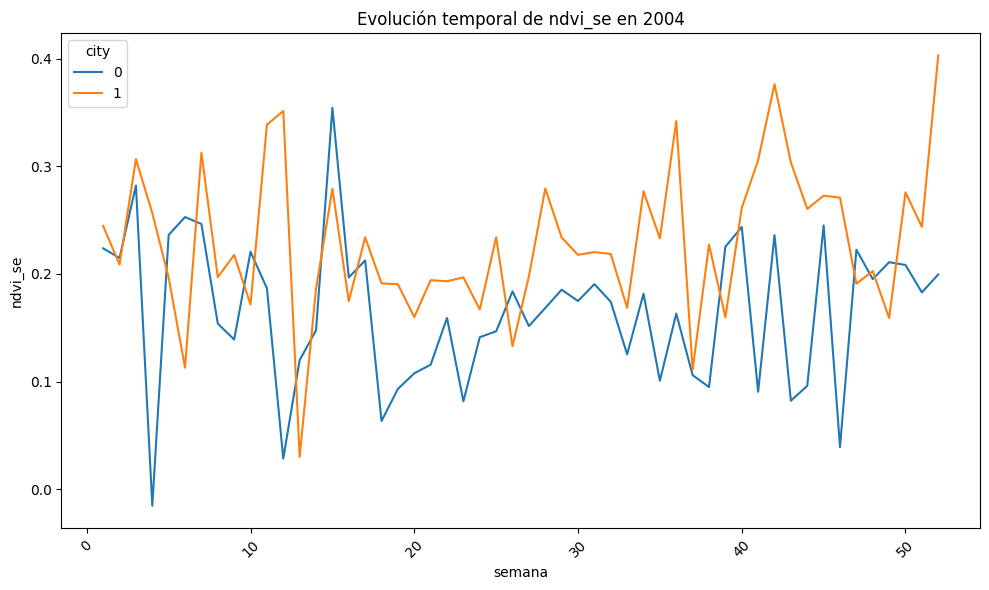

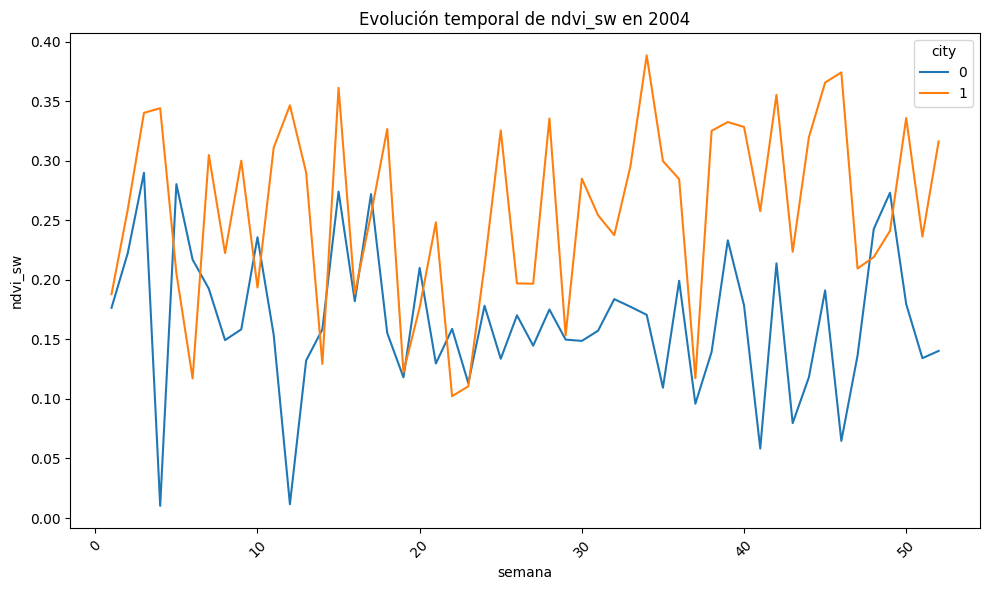

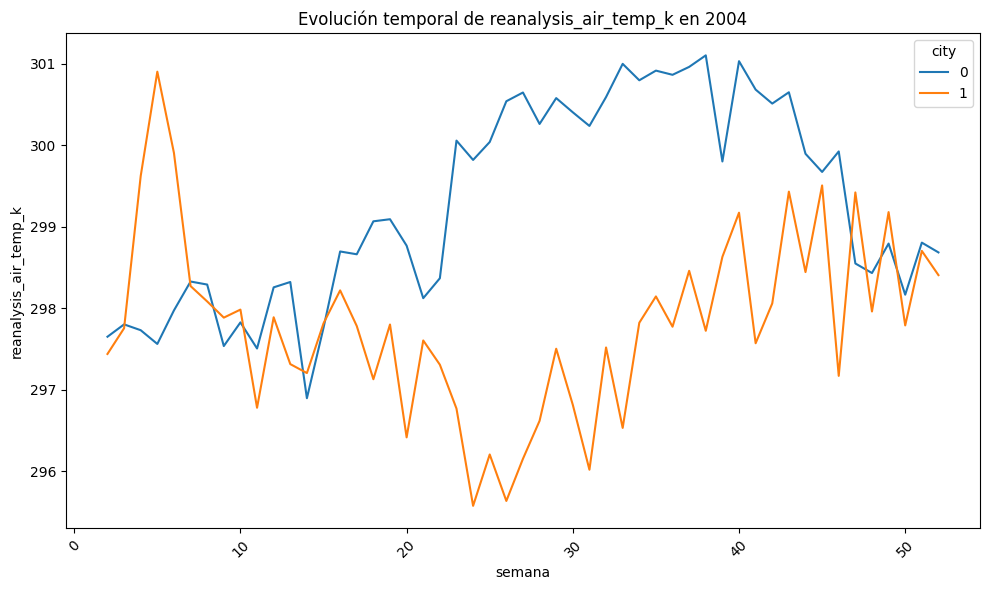

...

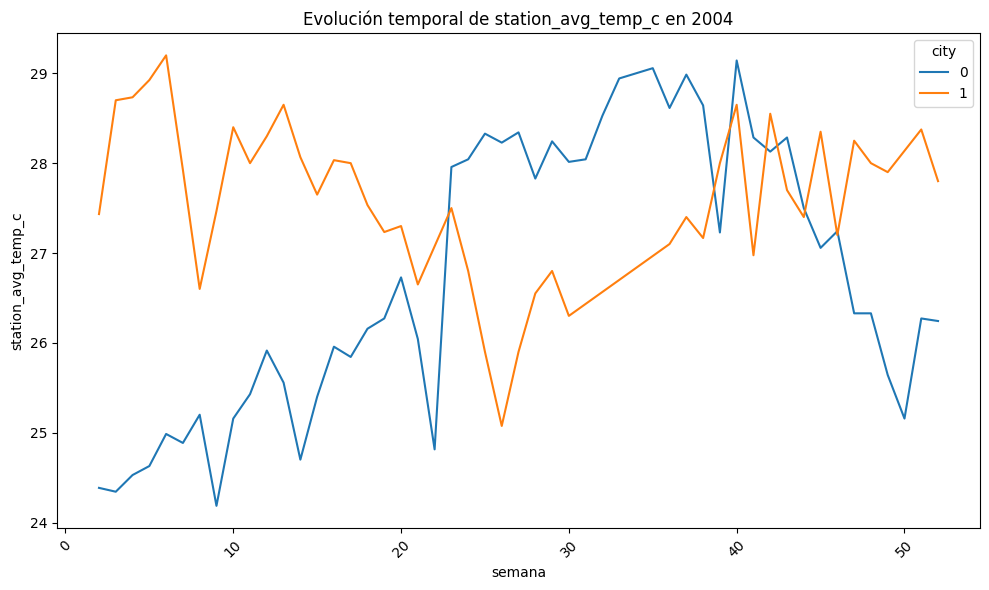

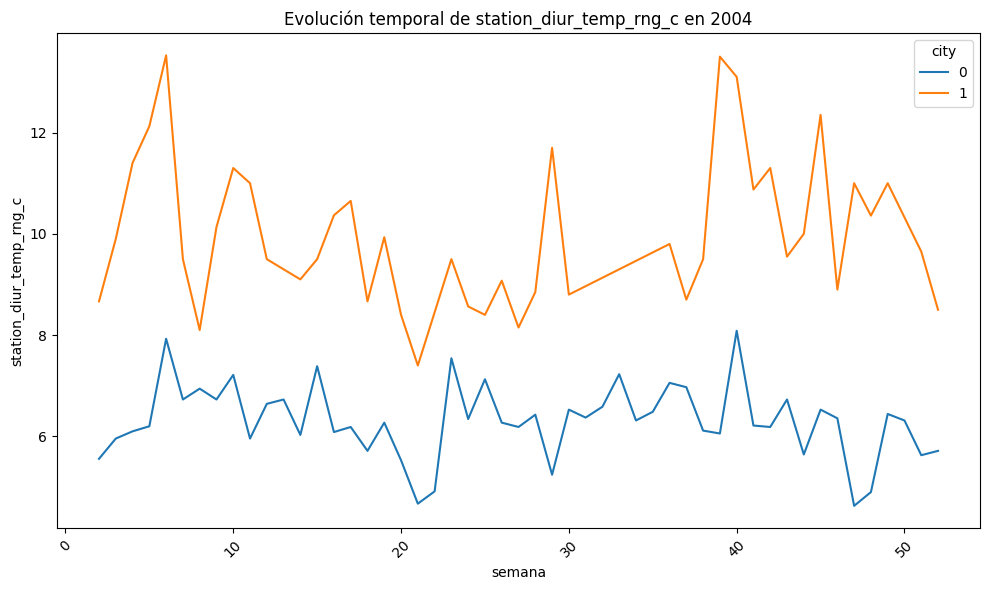

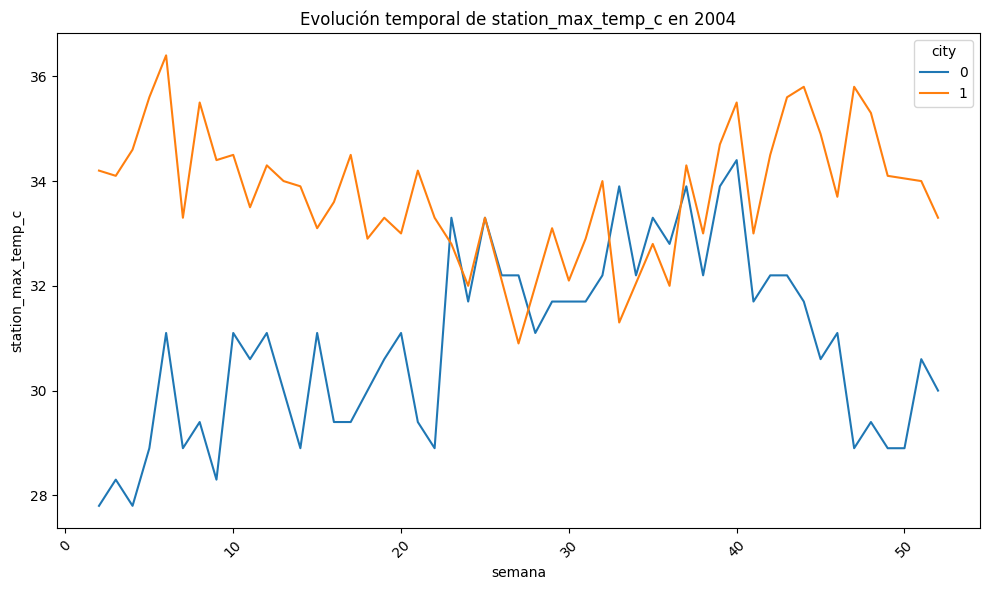

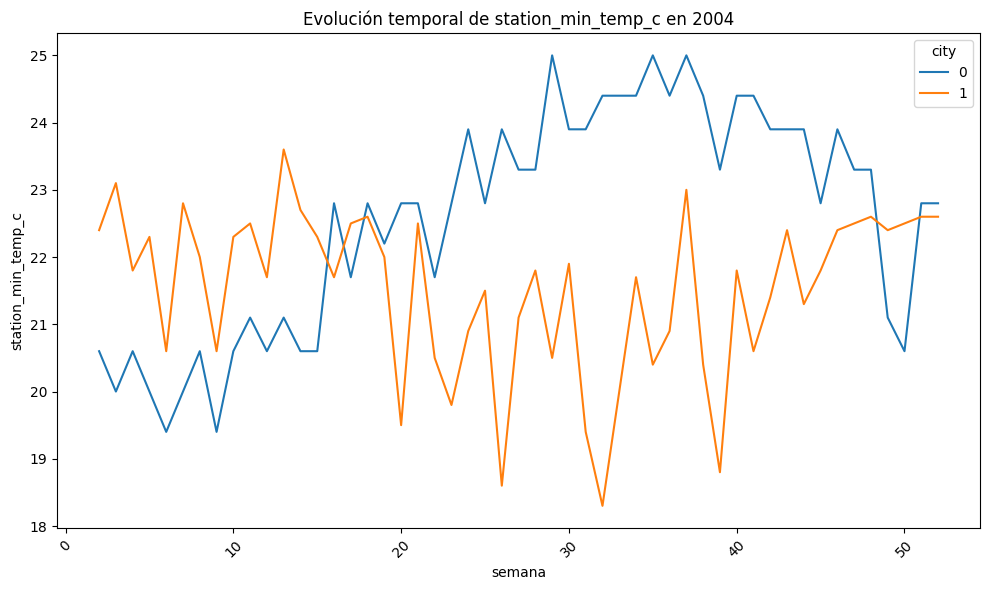

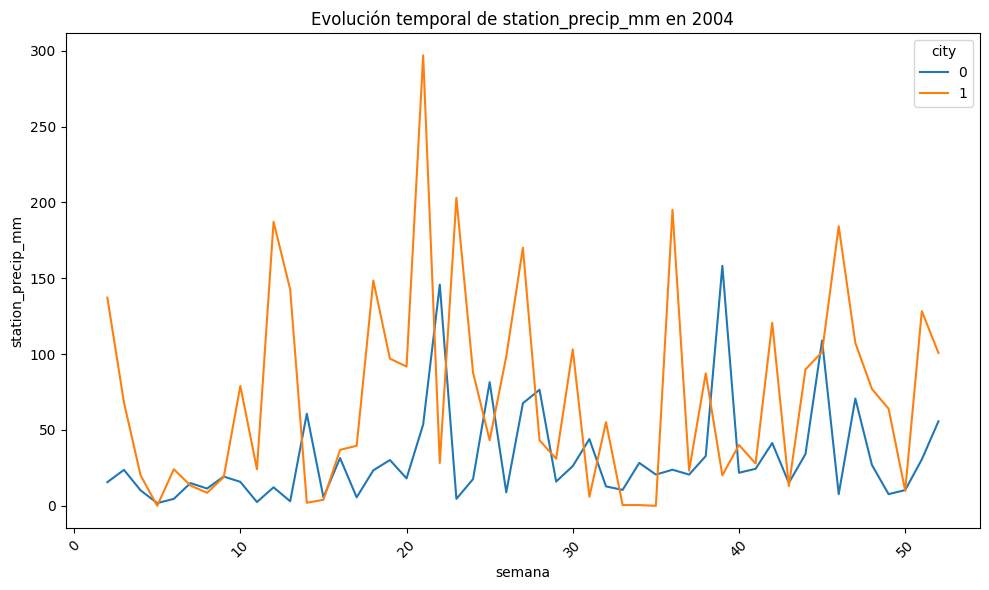

In [ ]:
# Filtro los datos para el año 2004
train_2004 = train[train['year'] == 2004]

# Grafico las series de tiempo para cada característica
for column in train_2004.columns[4:]:
    plt.figure(figsize=(10, 6))
    sns.lineplot(x='weekofyear', y=column, data=train_2004, hue='city')
    plt.title(f'Evolución temporal de {column} en 2004')
    plt.xlabel('semana')
    plt.ylabel(column)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


Considerando que la ciudad de San Juan se encuentra en el hemisferio norte e Iquitos en el hemisferio sur, los gráficos muestran una estacionalidad clara, lo cual resulta lógico dado que las condiciones climáticas están intrínsecamente ligadas a la época del año en que se realizan las mediciones.

San Juan tiene un clima tropical, con temperaturas cálidas durante todo el año y dos estaciones principales: la estación seca (de diciembre a abril) y la estación lluviosa (de mayo a noviembre). Esto se hace evidente en los gráficos de *'station_max_temp_c', 'reanalysis_specific_hum_g_per_kg' y 'reanalysis_sat_precip_amt_mm'* donde se puede apreciar que las máximas temperaturas y mayores precipitaciones, por consiguiente humedad, se presentan entre las semanas 23-42 aproximadamente, que representan el verano e inicios del otoño. Algo similar sucede con Iquitos entre las semanas 45-10 aproximadamente, que tiene un clima ecuatorial, cálido y húmedo, con intensas lluvias entre diciembre y abril.

Del análisis de las precedentes gráficas temporales y debido a este comportamiento estacional que manifiestan las características durante el transcurso de un año, surje la idea que la variable temporal más representativa para el presente análisis y posteriores agrupaciones es *'weekofyear'*. Con lo cual se decide eliminar las variables *'year' y 'week_start_date'*, además esta última es una variable de tipo cadena de texto sin formato.


In [ ]:
# Eliminar variables year y week_start_date
train.drop(['year', 'week_start_date'], axis = 1, inplace = True)
train.shape

(1456, 20)

### **Dataset dividido por ciudades (sj e iq)**

Por lo visto anteriormente, y antes de comenzar a transformar el dataset, considero que es conveniente dividirlo por ciudades y hacer una pequeña segunda iteración en la exploración del mismo por si surge algún nuevo insight propio de cada región.

In [ ]:
#Divido el dataset de entrenamiento por ciudad
sj_train = train[train['city']==0]
iq_train = train[train['city']==1]

#Tamaño dataset San Juan e Iquitos
sj_train.shape, iq_train.shape

((936, 20), (520, 20))

#### **Estadísticas generales San Juan e Iquitos**

In [ ]:
#Estadísticas descriptivas San Juan
sj_train.describe(include=['float64'])

,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
count,745.000000,887.000000,917.000000,917.000000,930.000000,930.000000,930.000000,930.000000,930.000000,930.000000,927.000000,930.000000,930.000000,930.000000,930.000000,930.000000,930.000000,930.000000
mean,0.057925,0.067469,0.177655,0.165956,299.163653,299.276920,301.398817,297.301828,30.465419,78.568181,35.470809,16.552409,2.516267,27.006528,6.757373,31.607957,22.600645,26.785484
std,0.107153,0.092479,0.057166,0.056073,1.236429,1.218637,1.258927,1.294705,35.628055,3.389488,44.606137,1.560923,0.498892,1.415473,0.835993,1.717297,1.506277,29.325811
min,-0.406250,-0.456100,-0.015533,-0.063457,295.938571,296.114286,297.800000,292.600000,0.000000,66.735714,0.000000,11.715714,1.357143,22.842857,4.528571,26.700000,17.800000,0.000000
25%,0.004500,0.016425,0.139283,0.129157,298.195000,298.300000,300.400000,296.300000,10.825000,76.246071,0.000000,15.236429,2.157143,25.842857,6.200000,30.600000,21.700000,6.825000
50%,0.057700,0.068075,0.177186,0.165971,299.254286,299.378571,301.500000,297.500000,21.300000,78.667857,20.800000,16.845714,2.457143,27.228571,6.757143,31.700000,22.800000,17.750000
75%,0.111100,0.115200,0.212557,0.202771,300.132857,300.228571,302.400000,298.400000,37.000000,80.963214,52.180000,17.858571,2.800000,28.185714,7.285714,32.800000,23.900000,35.450000
max,0.493400,0.437100,0.393129,0.381420,302.200000,302.164286,304.300000,299.900000,570.500000,87.575714,390.600000,19.440000,4.428571,30.071429,9.914286,35.600000,25.600000,305.900000


In [ ]:
#Estadísticas descriptivas Iquitos
iq_train.describe(include=['float64'])

,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
count,517.000000,517.000000,517.000000,517.000000,516.000000,516.000000,516.000000,516.000000,516.000000,516.000000,516.000000,516.000000,516.000000,483.000000,483.000000,506.000000,512.000000,504.000000
mean,0.263869,0.238783,0.250126,0.266779,297.869538,299.133043,307.082752,292.866667,57.609864,88.639117,64.245736,17.096110,9.206783,27.530933,10.566197,34.004545,21.196680,62.467262
std,0.081370,0.076751,0.077354,0.086345,1.170997,1.332073,2.382980,1.663069,50.286555,7.583889,35.218995,1.445769,2.448525,0.921769,1.535496,1.325261,1.260327,63.245958
min,0.061729,0.035860,0.029880,0.064183,294.635714,294.892857,300.000000,286.900000,0.000000,57.787143,0.000000,12.111429,3.714286,21.400000,5.200000,30.100000,14.700000,0.000000
25%,0.200000,0.179540,0.194743,0.204129,297.092500,298.221429,305.200000,291.975000,24.065000,84.295000,39.105000,16.102857,7.371429,27.000000,9.500000,33.200000,20.600000,17.200000
50%,0.263643,0.232971,0.249800,0.262143,297.822857,299.121429,307.050000,293.050000,46.440000,90.917143,60.470000,17.428571,8.964286,27.600000,10.625000,34.000000,21.300000,45.300000
75%,0.319971,0.293929,0.302300,0.325150,298.649286,300.123214,308.700000,294.200000,71.072500,94.563929,85.757500,18.180357,11.014286,28.100000,11.655000,34.900000,22.000000,85.950000
max,0.508357,0.454429,0.538314,0.546017,301.637143,302.928571,314.000000,296.000000,362.030000,98.610000,210.830000,20.461429,16.028571,30.800000,15.800000,42.200000,24.200000,543.300000


#### **Percentiles y correlaciones San Juan e Iquitos**

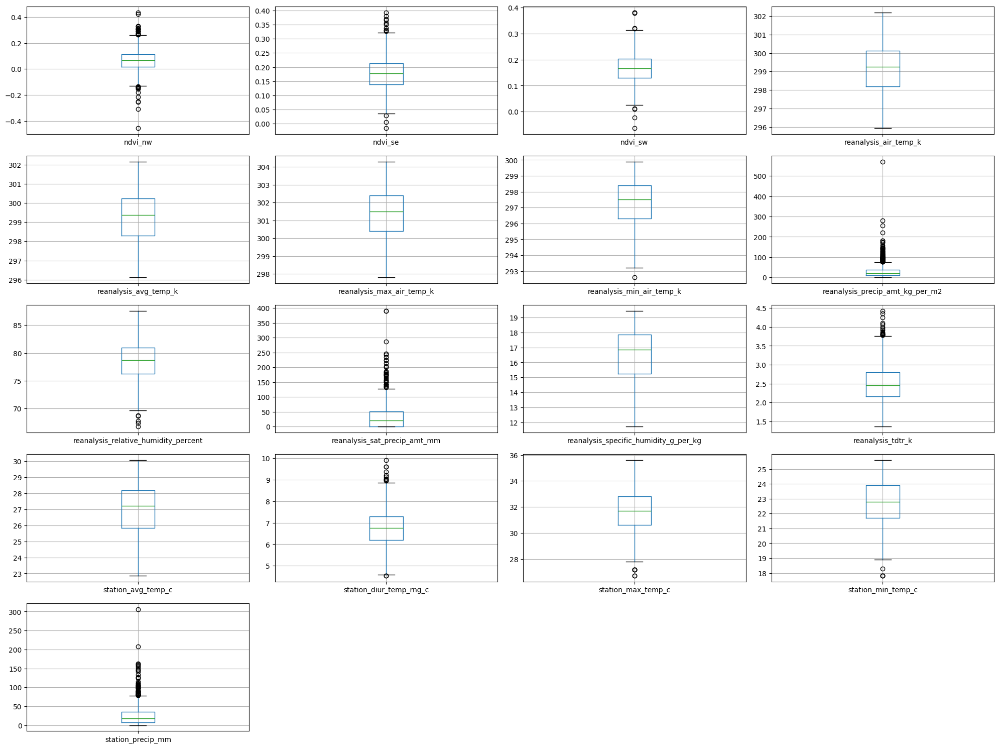

In [ ]:
# Boxplot San Juan
nc = sj_train.columns[3:20].tolist()

plt.figure(figsize=[20, 15])
for c in range(len(nc)):
    plt.subplot(math.ceil(len(nc)/4), 4, c+1)
    sj_train.boxplot(nc[c])
plt.tight_layout()
plt.show()

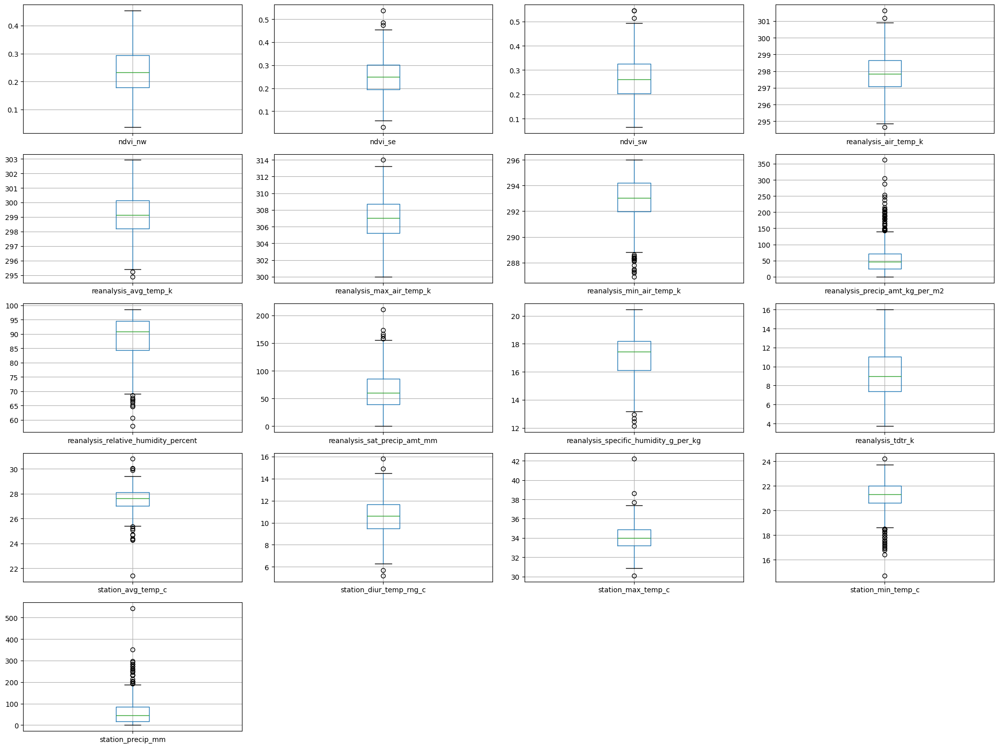

In [ ]:
# Boxplot Iquitos
nc = iq_train.columns[3:20].tolist()

plt.figure(figsize=[20, 15])
for c in range(len(nc)):
    plt.subplot(math.ceil(len(nc)/4), 4, c+1)
    iq_train.boxplot(nc[c])
plt.tight_layout()
plt.show()

 En ambos ciudades, se observan valores atípicos en varias características, como temperaturas mínimas y las relacionadas con precipitación y humedad, lo que junto con la mayor variabilidad de estas últimas sugiere eventos extremos, como patrones de lluvia y sequía en la región.


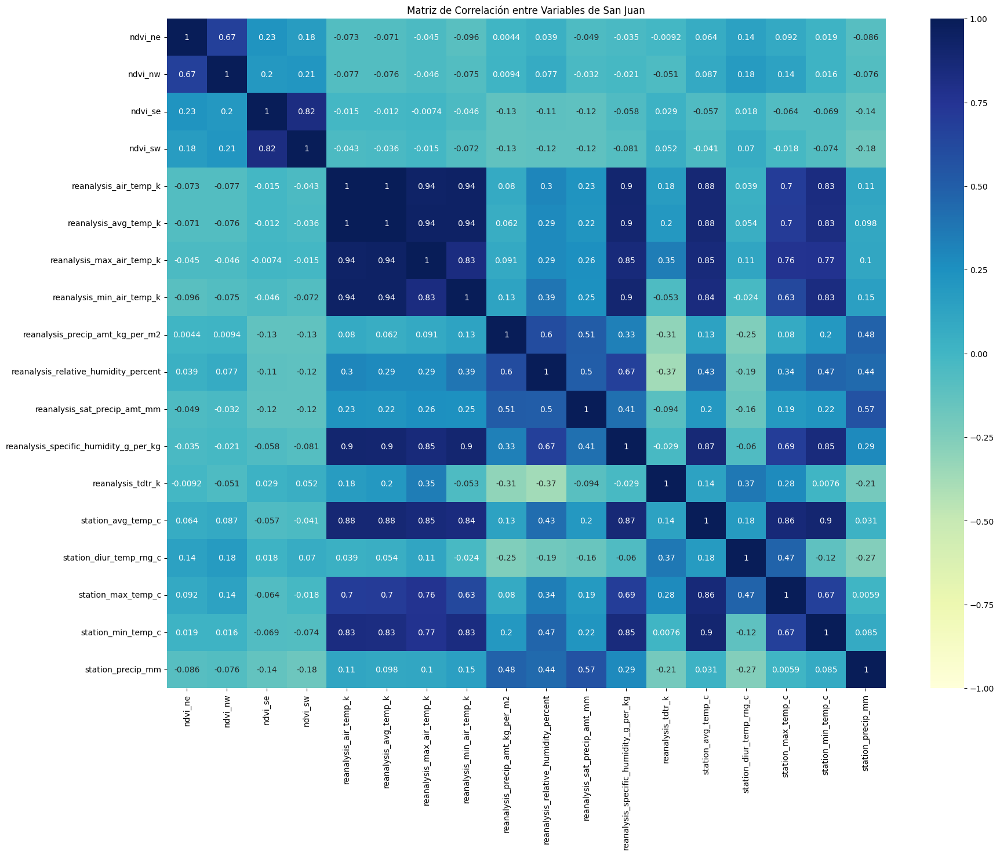

In [ ]:
# Matriz de correlación San Juan
numeric_data = sj_train.select_dtypes(include=['float64'])
plt.figure(figsize=(20, 15))
sns.heatmap(numeric_data.corr(), annot=True, cmap='YlGnBu', vmin=-1, vmax=1)
plt.title('Matriz de Correlación entre Variables de San Juan')
plt.show()

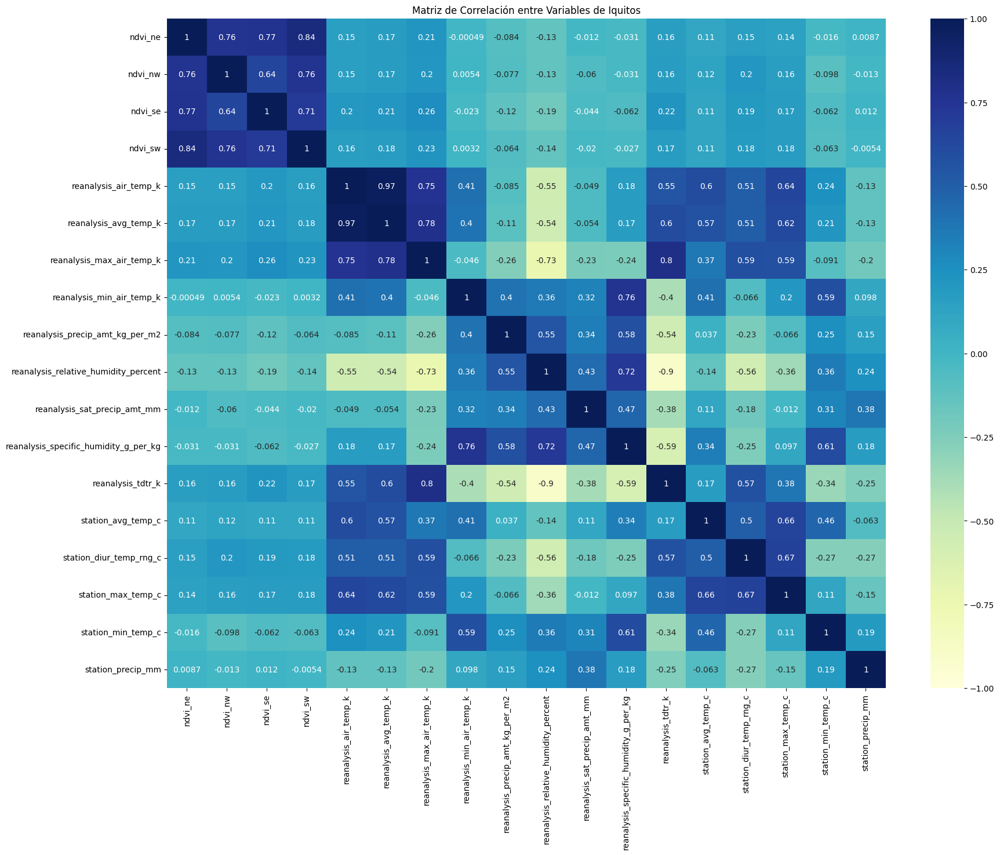

In [ ]:
# Matriz de correlación Iquitos
numeric_data = iq_train.select_dtypes(include=['float64'])
plt.figure(figsize=(20, 15))
sns.heatmap(numeric_data.corr(), annot=True, cmap='YlGnBu', vmin=-1, vmax=1)
plt.title('Matriz de Correlación entre Variables de Iquitos')
plt.show()

Se observa claramente como las mismas variables para una ciudad y otra se correlacionan de forma diferente entre sí. Esto es muy evidente para el caso de las variables de temperaturas del grupo reanalysis, las cuales se observan más  fuertemente correlaccionadas para la ciudad de San Juan en contraposición con Iquitos. Sin embargo todas tienen correlaciones inferiores a 0.95, salvo el caso de *'reanalysis_avg_temp_k' y 'reanalysis_air_temp_k'*, que tienen una correlación de 1 en San Juan y de 0.97 en Iquitos, reforzando la idea extraída de los diagramas 2 a 2. Esto, sumado a que una temperatura media no representa lo mismo que una temperatura puntual, no hace obvia la eliminación de una de las características de este par, por lo cual se conservarán ambas para el análisis.
Por último, las diferencias de comportamiento observadas en los gráficos anteriores para ambas ciudades no justifican transformaciones por ciudades del dataset, con lo cual se continuará trabajando con el dataset como un todo.


## Preprocesado y transformación
---

### **Estudio y tratamiento de valores nulos**

Se chequea si hay valores perdidos o faltantes en el dataset completo, ya que la mayoría de los modelos no aceptan su existencia.

In [ ]:
train.select_dtypes(include=['float64']).isnull().sum()

,0
ndvi_ne,194
ndvi_nw,52
ndvi_se,22
ndvi_sw,22
reanalysis_air_temp_k,10
reanalysis_avg_temp_k,10
reanalysis_max_air_temp_k,10
reanalysis_min_air_temp_k,10
reanalysis_precip_amt_kg_per_m2,10
reanalysis_relative_humidity_percent,10


In [ ]:
# Porcentaje de valores nulos por característica
null_percentage = train.select_dtypes(include=['float64']).isnull().sum() / len(train) * 100
null_percentage.sort_values(ascending=False, inplace=True)
print(null_percentage.round(4))


ndvi_ne                                  13.3242
ndvi_nw                                   3.5714
station_diur_temp_rng_c                   2.9533
station_avg_temp_c                        2.9533
station_precip_mm                         1.5110
ndvi_sw                                   1.5110
ndvi_se                                   1.5110
station_max_temp_c                        1.3736
station_min_temp_c                        0.9615
reanalysis_sat_precip_amt_mm              0.8929
reanalysis_avg_temp_k                     0.6868
reanalysis_max_air_temp_k                 0.6868
reanalysis_min_air_temp_k                 0.6868
reanalysis_precip_amt_kg_per_m2           0.6868
reanalysis_air_temp_k                     0.6868
reanalysis_specific_humidity_g_per_kg     0.6868
reanalysis_tdtr_k                         0.6868
reanalysis_relative_humidity_percent      0.6868
dtype: float64


Se observa que hay valores perdidos en todas las columnas de características relacionadas con mediciones climatológicas y ambientales. La característica con mayor cantidad de valores faltantes es *'ndvi_ne'*, que tiene un 13.32% de datos perdidos sobre el total de datos registrados, mientras el resto está por debajo del 3.6%. Esto resalta la importancia de rellenar posteriormente estos valores de manera inteligente para luego construir los modelos.

A continuación, visualizaremos mejor esta información con un mapa de calor:

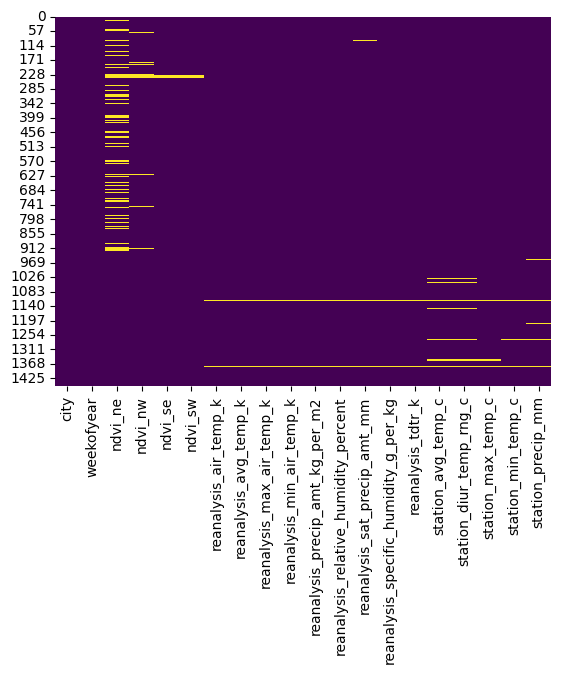

In [ ]:
# Mapa de calor para visualizar valores faltantes en el dataset
sns.heatmap(train[train.columns].isnull(), cmap="viridis", cbar=False) # amarillo para valores faltantes
plt.show()

Del mapas de calor, además de visualizar los valores faltantes previamente hallados y destacar la característica *'ndvi_ne'*, se ve también claramente que hay al menos 2 instancias que no tienen casi datos de la mayoría de las características (faltan datos de 14 de las 18 características climatológicas y ambientales, es decir 77.78% de valores faltantes). Por lo cual, seríe interesante determinar cuáles son exactamente y considerar eliminarlas, ya que no aportan nada o muy poca información.

In [ ]:
# Código para eliminar aquellas instancias que tengan más del 75% de sus características nulas

# Calculo el porcentaje de valores nulos por fila
null_percentage_per_row = train.isnull().sum(axis=1) / len(train.columns) * 100

# Identifico las instancias con más del 75% de valores nulos
instances_to_remove = train[null_percentage_per_row > 75].index

# Remuevo las instancias identificadas del dataset
train_cleaned = train.drop(instances_to_remove)

# Imprimo la forma del dataset "original" y el limpio a fines comparativos
print("Forma dataset original:", train.shape)
print("Forma dataset limpio:", train_cleaned.shape)

# Asigno el dataset limpio al original para continuar el análisis
train = train_cleaned


Forma dataset original: (1456, 20)
Forma dataset limpio: (1451, 20)


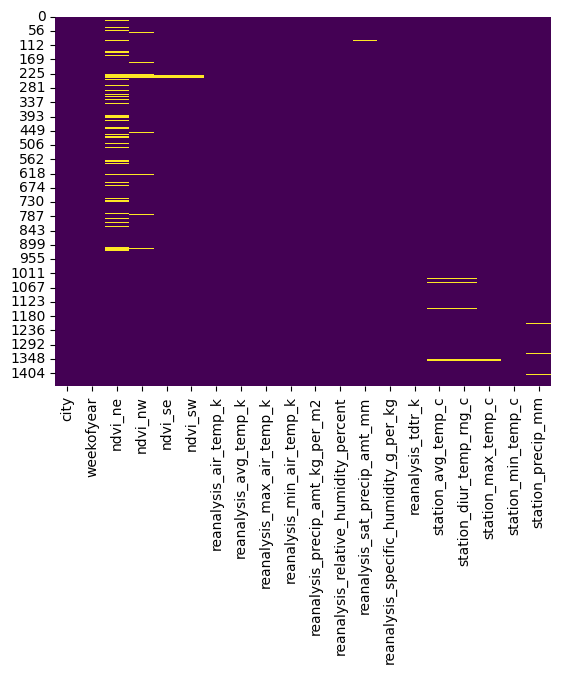

In [ ]:
# Nuevo mapa de calor para visualizar valores faltantes resultantes en el dataset
sns.heatmap(train[train.columns].isnull(), cmap="viridis", cbar=False) # amarillo para valores faltantes
plt.show()

Se observa que se eliminaron 5 instancias que poseían más del 75% de valores de características faltantes, una cantidad muy pequeña en comparación con las 1456 instancias originales. Por consiguiente, el porcentaje de nulos por característica habrá disminuido y por ello se recalcula:

In [ ]:
# Se recalcula porcentaje de valores nulos por característica
null_percentage = train.select_dtypes(include=['float64']).isnull().sum() / len(train) * 100
null_percentage.sort_values(ascending=False, inplace=True)
print(null_percentage.round(4))

ndvi_ne                                  13.0255
ndvi_nw                                   3.2391
station_diur_temp_rng_c                   2.6189
station_avg_temp_c                        2.6189
station_precip_mm                         1.1716
ndvi_sw                                   1.1716
ndvi_se                                   1.1716
station_max_temp_c                        1.0338
station_min_temp_c                        0.6203
reanalysis_sat_precip_amt_mm              0.5513
reanalysis_avg_temp_k                     0.3446
reanalysis_max_air_temp_k                 0.3446
reanalysis_min_air_temp_k                 0.3446
reanalysis_precip_amt_kg_per_m2           0.3446
reanalysis_air_temp_k                     0.3446
reanalysis_specific_humidity_g_per_kg     0.3446
reanalysis_tdtr_k                         0.3446
reanalysis_relative_humidity_percent      0.3446
dtype: float64


Existen diferentes enfoques para tratar los valores nulos existentes de las características: eliminar las columnas que contienen los valores faltantes, imputar con la media/mediana/moda de la columna o imputar con alguna técnica avanzada.

Eliminar la columna no parece una alternativa viable porque estamos perdiendo características que por lo visto en el análisis exploratorio pueden tener impacto en el modelo. Imputar con las estadísticas tampoco parece conveniente en todos los casos, principalmente en aquellos casos con un porcentaje alto de nulos, como es el caso de *'ndvi_ne'*. Lo que se propone es realizar una imputación con un método sencillo como **'interpolate'**, que rellena los valores faltantes realizando una interpolación lineal. Es una suposición razonable usar la interpolación lineal que supone relación lineal entre las variables climáticas y ambientales que tengo, ya que son de tipo continuo o series de tiempo. No se utiliza el método 'ffill' porque rellenar con el valor anterior en el caso de variables climáticas que pueden modificarse de una semana a la otra no parece apropiado.

Sin embargo, previamente a utilizar 'interpolate' vamos a rellenar los nulos **utilizando el conocimiento del dominio del problema** y la exploración de datos que realizamos, que parece lo más acertado.
Por ejemplo, para los valores faltantes de *'station_avg_temp_c'* puedo utilizar los valores de las mismas instancias de *'station_max_temp_c' y 'station_min_temp_c'* para calcularlos, ya que disponemos de dichos valores como se puede ver en el mapa de calor y darán una aproximación más realista. Consideraciones similares se realizan para otras variables, como se puede observar en los comentarios del propio código realizado.

In [ ]:
# IMPUTAR VALORES FALTANTES USANDO INFORMACIÓN DEL DOMINIO DEL PROBLEMA

# La temperatura promedio de temperaturas en grado centígrados en la estación meteorológica las puedo obtener como el promedio de las temperaturas máximas y mínimas
train['station_avg_temp_c'] = train['station_avg_temp_c'].fillna((train['station_min_temp_c'] + train['station_max_temp_c']) / 2)

# Continuo imputando valores faltantes de temperaturas en grados centígrados usando las mismas variables del grupo de reanalysis, convirtiendo los grados Kelvin a centígrados ( 0°C = 273.15 K)
train['station_avg_temp_c'] = train['station_avg_temp_c'].fillna((train['reanalysis_avg_temp_k'] - 273.15))
train['station_max_temp_c'] = train['station_max_temp_c'].fillna((train['reanalysis_max_air_temp_k'] - 273.15))
train['station_min_temp_c'] = train['station_min_temp_c'].fillna((train['reanalysis_min_air_temp_k'] - 273.15))
train['station_diur_temp_rng_c'] = train['station_diur_temp_rng_c'].fillna((train['reanalysis_tdtr_k'] - 273.15))

# Para las variables de precipitación con las mismas unidades de medición, se puede usar la mediana por ciudad y semana del año, considerando la estacionalidad de las lluvias.
# Se usa la mediana y no la media, porque como se vio en EDA la distribución de estas variables es altamente sesgada.
for col in ['reanalysis_sat_precip_amt_mm', 'station_precip_mm']:
    train[col] = train.groupby(['city', 'weekofyear'])[col].transform(lambda x: x.fillna(x.median()))

train.isnull().sum()

,0
city,0
weekofyear,0
ndvi_ne,189
ndvi_nw,47
ndvi_se,17
ndvi_sw,17
reanalysis_air_temp_k,5
reanalysis_avg_temp_k,5
reanalysis_max_air_temp_k,5
reanalysis_min_air_temp_k,5


In [ ]:
# PARA EL RESTO DE LAS VARIABLES SE PUEDE USAR LA INTERPOLACIÓN LINEAL, COMO SE PROPUSO INICIALMENTE
for col in train.columns:
  if train[col].isnull().any():
    train[col] = train[col].interpolate(method='linear')

In [ ]:
# Verificar si quedan valores nulos
train.isnull().sum()

,0
city,0
weekofyear,0
ndvi_ne,0
ndvi_nw,0
ndvi_se,0
ndvi_sw,0
reanalysis_air_temp_k,0
reanalysis_avg_temp_k,0
reanalysis_max_air_temp_k,0
reanalysis_min_air_temp_k,0


Dado que todos las columnas tienen valor '0'(cero), eso nos indica que todas han sido rellenadas correctamente y ya no quedan valores nulos.

### **Estudio y tratamiento de outliers**

De la visualización de diagramas de caja para las ciudades en el EDA detectamos que hay valores atípicos o fuera de rango en nuestro conjunto de datos. Como están relacionados a variables climáticas, estos podrían tener información importante y esencial para entender el comportamiento de nuestro dataset y futuro modelo. Sin embargo, vamos a tratarlos utilizando el criterio del rango interquartílico y ver el impacto en dataset resultante:

In [ ]:
# Función para remover los outliers de mi dataframe
def remove_outliers(df):
    df_no_outliers = df.drop(['city', 'weekofyear'], axis=1)
    for col in df_no_outliers.columns:
        Q1 = df_no_outliers[col].quantile(0.25)
        Q3 = df_no_outliers[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df_no_outliers = df_no_outliers[(df_no_outliers[col] >= lower_bound) & (df_no_outliers[col] <= upper_bound)]
    return df_no_outliers

remove_outliers(train)

,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,0.122600,0.103725,0.198483,0.177617,297.572857,297.742857,299.8,295.9,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0
1,0.169900,0.142175,0.162357,0.155486,298.211429,298.442857,300.9,296.4,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6
2,0.032250,0.172967,0.157200,0.170843,298.781429,298.878571,300.5,297.3,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4
3,0.128633,0.245067,0.227557,0.235886,298.987143,299.228571,301.4,297.0,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0
4,0.196200,0.262200,0.251200,0.247340,299.518571,299.664286,301.9,297.5,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,0.170100,0.142117,0.117914,0.139343,298.754286,300.342857,306.1,295.6,95.83,90.648571,47.31,18.522857,8.314286,27.800000,9.266667,34.2,22.0,62.3
1450,0.263071,0.272500,0.258271,0.244500,297.648571,298.707143,308.7,290.1,8.80,78.998571,1.15,14.908571,11.242857,25.633333,9.200000,34.0,20.0,2.5
1453,0.247057,0.146057,0.250357,0.233714,296.598571,297.592857,305.5,292.4,50.60,94.280000,58.94,17.008571,7.500000,24.400000,6.900000,32.2,19.2,7.4
1454,0.333914,0.245771,0.278886,0.325486,296.345714,297.521429,306.1,291.9,62.33,94.660000,59.67,16.815714,7.871429,25.433333,8.733333,31.2,21.0,16.0


De las 1451 instancias que quedaron post tratamiento de nulos, se están eliminando 493 instancias (958 instancias finales), lo que representa un 33.97% de los casos. Lo que se encuentra muy por encima del 20% y no parece recomendable, dado que puede introducir sesgos que limiten el alcance de las conclusiones del análisis y modelado posterior. Por lo tanto, si bien se podrían transformar o utilizar métodos robustos para tratarlos, considerando que también podrían brindar información importante sobre eventos climáticos extremos como se mencionó anteriormente o formar su propio clúster, se decide conservarlos.

### Estadísticas generales post preprocesado

In [ ]:
train_prepro = train.copy()

In [ ]:
train_prepro.describe(include=['float64'])

,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
count,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000
mean,0.131656,0.128011,0.203166,0.202092,298.699498,299.223156,303.422743,295.718677,40.151733,82.167472,45.581158,16.745225,4.901398,27.165660,1.881729,32.453549,22.096382,39.422467
std,0.137188,0.119338,0.073723,0.083468,1.361537,1.261339,3.233143,2.562014,43.381489,7.156206,43.694504,1.541798,3.543842,1.299260,40.565977,1.959432,1.572373,47.233605
min,-0.406250,-0.456100,-0.015533,-0.063457,294.635714,294.892857,297.800000,286.900000,0.000000,57.787143,0.000000,11.715714,1.357143,21.400000,-267.621429,26.700000,14.700000,0.000000
25%,0.037475,0.048100,0.153986,0.144600,297.657143,298.257143,301.000000,293.900000,13.150000,77.181429,9.630000,15.553571,2.328571,26.271429,6.442857,31.100000,21.100000,8.700000
50%,0.115700,0.115967,0.195729,0.190143,298.642857,299.285714,302.400000,296.200000,27.290000,80.300000,38.170000,17.085714,2.857143,27.400000,7.242857,32.800000,22.200000,24.100000
75%,0.231457,0.213086,0.247536,0.246629,299.830000,300.207143,305.500000,297.900000,52.350000,86.407143,70.115000,17.976429,7.621429,28.142857,9.500000,33.900000,23.300000,54.100000
max,0.508357,0.454429,0.538314,0.546017,302.200000,302.928571,314.000000,299.900000,570.500000,98.610000,390.600000,20.461429,16.028571,30.800000,15.800000,42.200000,25.600000,543.300000


---
# Características
---

El objetivo principal de esta sección, es crear nuevas características a partir de las existentes y luego identificar y retener las características más relevantes para el problema en cuestión, eliminando aquellas que no aportan valor o pueden introducir ruido. Esto mejora la eficacia del modelo al reducir la complejidad, el riesgo de sobreajuste y los tiempos de entrenamiento, además de facilitar la interpretación de los resultados.

## Creación de características

Se crean y se experimenta con nuevas variables basadas en combinaciones de datos climáticos y variables derivadas de las relaciones detectadas en EDA y conociendo la naturaleza de los datos, con el fin de mejorar la capacidad predictiva del modelo.
Se proponen las siguientes nuevas características:

*   **Promedio de NDVI ('avg_ndvi')**: Como se vio en el EDA las variables *'ndvi'* están bastante correlacionadas (>0.5), por lo que resultaría provechoso calcular el promedio de todas las variables para representar la salud media de la vegetación en la zona.

*   **Rango de NDVI ('rng_ndvi')**: Para representar la variabilidad de las características *'ndvi'* se puede calcular el rango entre el valor máximo y mínimo, como se ve en los datos dados de la temperatura, por ejemplo.

*   **Temperatura del aire media ('avg_air_temp')**: Dado que las variables 'station_avg_temp_c', 'reanalysis_avg_temp_k' y 'reanalysis_air_temp_k' representan el promedio de la temperatura del aire medidas con diferentes metodologías y representadas en diferentes escalas, se puede calcular el promedio de las mismas llevandolas a una misma escala considerando el factor de conversión ( 0°C = 273.15 K, ya que la escala Kelvin es la que posee el cero absoluto de temperatura 0K).

*   **Rango medio de temperatura diurna ('avg_temp_diur_rng')**: Dado que las variables 'station_diur_temp_rng_c' y 'reanalysis_tdtr_temp_k' representan el rango de la temperatura diurna medidas con diferentes metodologías y representadas en diferentes escalas, se puede calcular el promedio de las mismas. Como la diferencia de temperaturas tanto en grados centígrados como Kelvin es equivalente, no es necesario convertir las unidades.

*   **Precipitación media ('precip_avg')**: Dado que tanto la variable *'reanalysis_precip_amt_kg_per_m2'* como *'station_precip_mm'* representan la precipitación total de la instancia medidas con diferentes metodologías y las unidades de las mismas son equivalentes (kg/m^2 ~ mm de columna de agua), se puede calcular la precipitación media.
  
Para el caso de la humedad no se encuentra una clara característica para crear a partir de las dadas, por lo cual no se generará ninguna relacionada a este factor ambiental.

In [ ]:
# NDVI
train_prepro['avg_ndvi'] = train_prepro[['ndvi_ne','ndvi_nw','ndvi_se','ndvi_sw']].mean(axis=1)
train_prepro['rng_ndvi'] = (train_prepro[['ndvi_ne','ndvi_nw','ndvi_se','ndvi_sw']].max(axis=1) - train_prepro[['ndvi_ne','ndvi_nw','ndvi_se','ndvi_sw']].min(axis=1))

# Temperaturas
train_prepro['avg_air_temp'] = ((train_prepro['reanalysis_avg_temp_k']- 273.15) + (train_prepro['reanalysis_air_temp_k']- 273.15) +  train_prepro['station_avg_temp_c']) / 3
train_prepro['avg_temp_diur_rng'] = (train_prepro['reanalysis_tdtr_k'] + train_prepro['station_diur_temp_rng_c']) / 2

# Precipitación
train_prepro['precip_avg'] = train_prepro[['reanalysis_precip_amt_kg_per_m2','station_precip_mm']].mean(axis=1)

In [ ]:
train_prepro.columns

Index(['city', 'weekofyear', 'ndvi_ne', 'ndvi_nw', 'ndvi_se', 'ndvi_sw',
       'reanalysis_air_temp_k', 'reanalysis_avg_temp_k',
       'reanalysis_max_air_temp_k', 'reanalysis_min_air_temp_k',
       'reanalysis_precip_amt_kg_per_m2',
       'reanalysis_relative_humidity_percent', 'reanalysis_sat_precip_amt_mm',
       'reanalysis_specific_humidity_g_per_kg', 'reanalysis_tdtr_k',
       'station_avg_temp_c', 'station_diur_temp_rng_c', 'station_max_temp_c',
       'station_min_temp_c', 'station_precip_mm', 'avg_ndvi', 'rng_ndvi',
       'avg_air_temp', 'avg_temp_diur_rng', 'precip_avg'],
      dtype='object')

In [ ]:
train_prepro.head()

,city,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,...,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,avg_ndvi,rng_ndvi,avg_air_temp,avg_temp_diur_rng,precip_avg
0,0,18,0.122600,0.103725,0.198483,0.177617,297.572857,297.742857,299.8,295.9,...,25.442857,6.900000,29.4,20.0,16.0,0.150606,0.094758,24.819524,4.764286,24.00
1,0,19,0.169900,0.142175,0.162357,0.155486,298.211429,298.442857,300.9,296.4,...,26.714286,6.371429,31.7,22.2,8.6,0.157479,0.027725,25.689524,4.371429,13.27
2,0,20,0.032250,0.172967,0.157200,0.170843,298.781429,298.878571,300.5,297.3,...,26.714286,6.485714,32.2,22.8,41.4,0.133315,0.140717,26.024762,4.392857,33.75
3,0,21,0.128633,0.245067,0.227557,0.235886,298.987143,299.228571,301.4,297.0,...,27.471429,6.771429,33.3,23.3,4.0,0.209286,0.116433,26.462381,4.600000,8.95
4,0,22,0.196200,0.262200,0.251200,0.247340,299.518571,299.664286,301.9,297.5,...,28.942857,9.371429,35.0,23.9,5.8,0.239235,0.066000,27.275238,6.192857,9.00


Como se introdujeron nuevas características, es conveniente visualizar nuevamente la matriz de correlación:

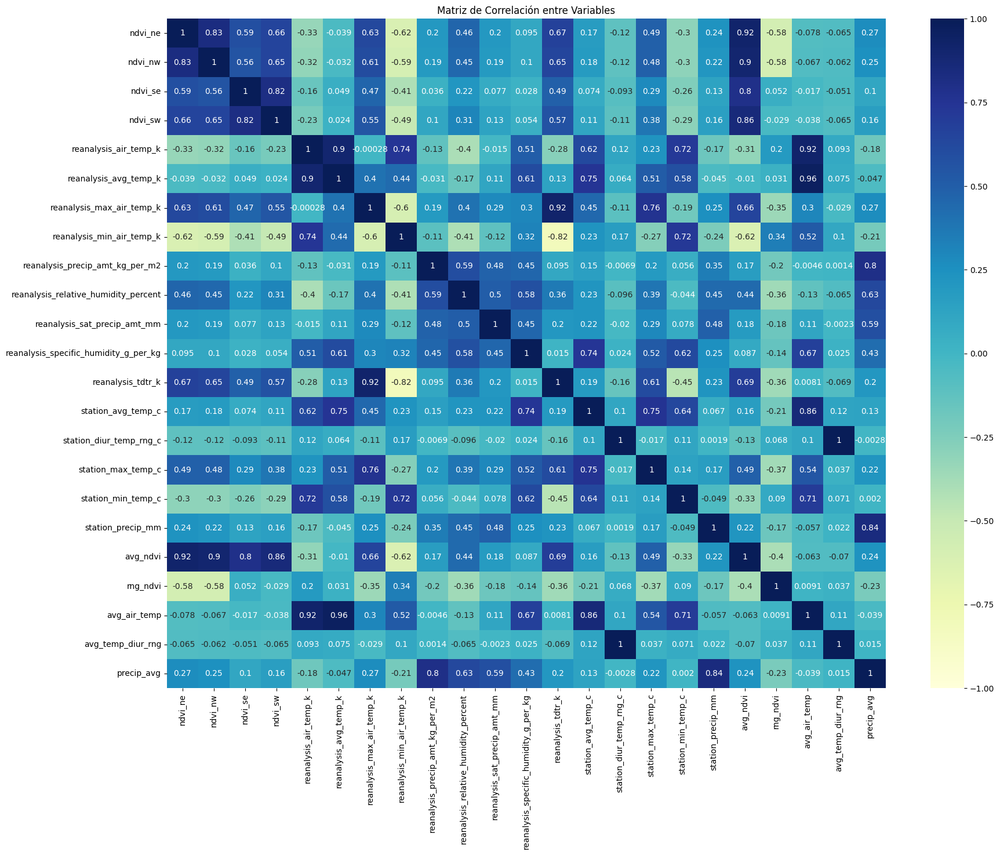

In [ ]:
# Visualizo nuevamente la matriz de correlación
numeric_data = train_prepro.select_dtypes(include=['float64'])
plt.figure(figsize=(20, 15))
sns.heatmap(numeric_data.corr(), annot=True, cmap='YlGnBu', vmin=-1, vmax=1)
plt.title('Matriz de Correlación entre Variables')
plt.show()

De la matriz se observa que algunas de las características creadas se encuentran altamente correlacionadas (coeficiente >= 0.95), lo cual como se ha mencionado anteriormente indican una redundancia de información que puede traer problemas en el modelado. Estas son:

*   'avg_air_temp' con 'reanalysis_avg_temp_k' (0.96)
*   'avg_temp_diur_rng' con 'station_diur_temp_rng_c' (1)

Es por ello que se decide eliminarlas:



In [ ]:
train_prepro.drop(['avg_air_temp', 'avg_temp_diur_rng'], axis = 1, inplace = True)

## Selección de características mediante clustering

En esta subsección, se realizará una ingeniería avanzada de características, aplicando clustering jerárquico y DBSCAN para la selección de características, con el fin de reducir el ruido y la redundancia en los datos obteniendo las características más relevantes o informativas. Para visualizar los resultados se utilizará Análisis de componentes (PCA), gráficos en 2D.

Para ello primero voy a trasponer el dataset:

### Dataset traspuesto

In [ ]:
# Transpongo df preprocesado
df_feat = train_prepro.transpose()
df_feat

,0,1,2,3,4,5,6,7,8,9,...,1446,1447,1448,1449,1450,1451,1452,1453,1454,1455
city,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
weekofyear,18.000000,19.000000,20.000000,21.000000,22.000000,23.000000,24.000000,25.000000,26.000000,27.000000,...,16.000000,17.000000,18.000000,19.000000,20.000000,21.000000,22.000000,23.000000,24.000000,25.000000
ndvi_ne,0.122600,0.169900,0.032250,0.128633,0.196200,0.154550,0.112900,0.072500,0.102450,0.147663,...,0.231486,0.239743,0.260814,0.168686,0.263071,0.342750,0.160157,0.247057,0.333914,0.298186
ndvi_nw,0.103725,0.142175,0.172967,0.245067,0.262200,0.174850,0.092800,0.072500,0.146175,0.121550,...,0.294686,0.259271,0.255786,0.158500,0.272500,0.318900,0.160371,0.146057,0.245771,0.232971
ndvi_se,0.198483,0.162357,0.157200,0.227557,0.251200,0.254314,0.205071,0.151471,0.125571,0.160683,...,0.331657,0.307786,0.257771,0.133071,0.258271,0.256343,0.136043,0.250357,0.278886,0.274214
ndvi_sw,0.177617,0.155486,0.170843,0.235886,0.247340,0.181743,0.210271,0.133029,0.123600,0.202567,...,0.244400,0.307943,0.340286,0.145600,0.244500,0.292514,0.225657,0.233714,0.325486,0.315757
reanalysis_air_temp_k,297.572857,298.211429,298.781429,298.987143,299.518571,299.630000,299.207143,299.591429,299.578571,300.154286,...,298.438571,299.048571,297.617143,297.278571,297.648571,299.334286,298.330000,296.598571,296.345714,298.097143
reanalysis_avg_temp_k,297.742857,298.442857,298.878571,299.228571,299.664286,299.764286,299.221429,299.528571,299.557143,300.278571,...,299.507143,300.028571,298.585714,297.935714,298.707143,300.771429,299.392857,297.592857,297.521429,299.835714
reanalysis_max_air_temp_k,299.800000,300.900000,300.500000,301.400000,301.900000,302.400000,301.300000,300.600000,302.100000,302.300000,...,304.700000,308.400000,304.700000,306.000000,308.700000,309.700000,308.500000,305.500000,306.100000,307.800000
reanalysis_min_air_temp_k,295.900000,296.400000,297.300000,297.000000,297.500000,298.100000,297.700000,298.400000,297.700000,298.700000,...,294.700000,294.600000,294.600000,294.000000,290.100000,294.500000,291.900000,292.400000,291.900000,292.300000


### Análisis de componentes (PCA)

In [ ]:
# 1ro) Estandarizo porque el filtrado puede haber cambiado la distribución
train_prepro_st = StandardScaler().fit_transform(train_prepro)

# 2do) Aplico PCA
pca = PCA()

#San Juan
pca.fit(train_prepro_st)
X_train_prepro_pca = pca.transform(train_prepro_st)

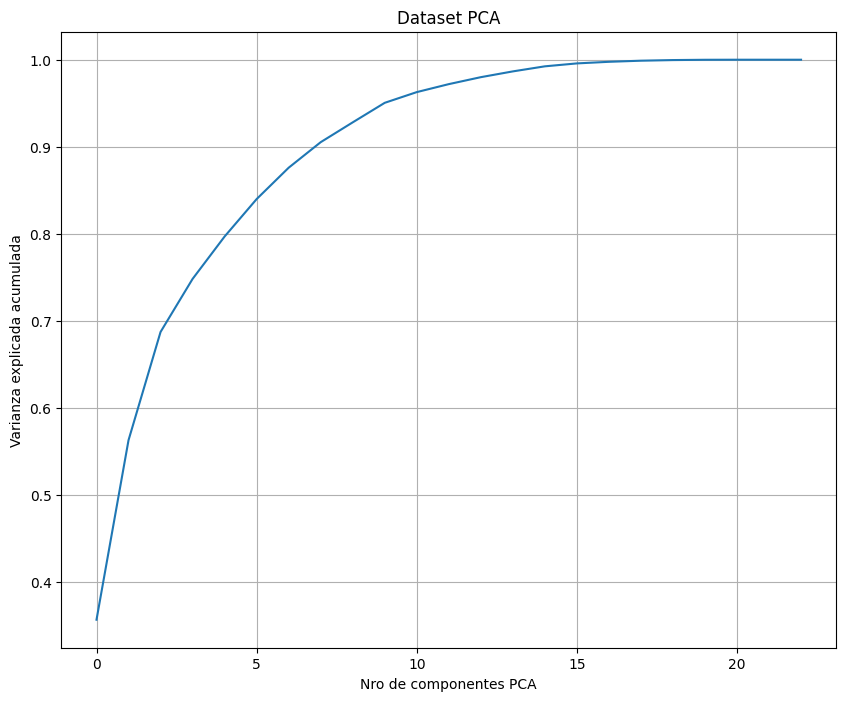

In [ ]:
#Plot PCA
plt.figure(figsize=(10, 8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Nro de componentes PCA')
plt.ylabel('Varianza explicada acumulada')
plt.title('Dataset PCA')
plt.grid(True)
plt.show()

El gráfico anterior muestra la relación entre la varianza explicada acumulada y los componentes del PCA para el dataset preprocesado. La varianza aumenta hasta estabilizarse en un número mayor de componentes. El análisis de este gráfico nos permite identificar la cantidad mínima de componentes que capturan la mayor parte de la variabilidad en los datos.
Se observa que con aproximadamente 7 componentes se captura el 90% de la varianza total. Después de ese punto, el incremento en la varianza explicada se ralentiza, lo que sugiere que añadir más componentes contribuye poco a la explicación adicional de la variabilidad en los datos.

### Clustering jerárquico

Podemos utilizar clustering jerárquico para observar las relaciones de similitud entre el desarrollo de las variables en el dataset preprocesado, traspuesto y estandarizado. Aquellos grupos de variables que sean similares entre ellas pueden ser resumidas escogiendo una de ellas y de esa forma reduciríamos la dimensionalidad del conjunto de datos.
En este paso utilizaremos el código proporcionado por el profesor de Machine Learning en el notebook 6-Selección de características.

Componentes lineales:
 [[ 0.02653517  0.02651319  0.02659353 ...  0.02653045  0.02653736
   0.02656378]
 [-0.01428828 -0.01883151 -0.00447634 ... -0.00429071  0.00149504
  -0.00398964]]

Ratio de variabilidad:  [0.97326468 0.01377442] 



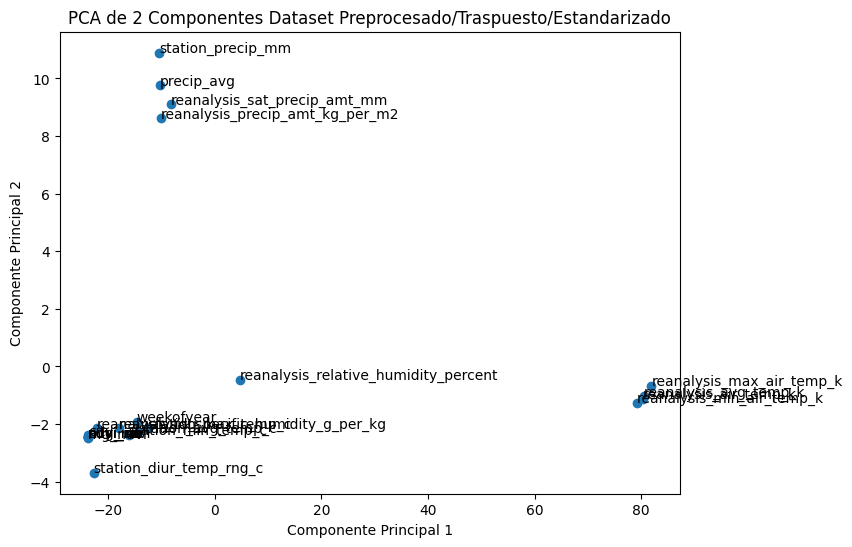

In [ ]:
# Normalización
scaler = StandardScaler()
features_norm = scaler.fit_transform(df_feat)

# Análisis de componentes principales (PCA)
estimator = PCA (n_components=2)
X_pca = estimator.fit_transform(features_norm)
names = df_feat.index
print("Componentes lineales:\n", estimator.components_)
print("\nRatio de variabilidad: ", estimator.explained_variance_ratio_, "\n")

# Visualización
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1])
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.title('PCA de 2 Componentes Dataset Preprocesado/Traspuesto/Estandarizado')
for i, name in enumerate(names):
    plt.annotate(name, (X_pca[i, 0], X_pca[i, 1]))
plt.show()

Las primeras dos componentes juntas explican el 98.7% de la varianza total (97.32% + 1.38%).

Se puede ver que la mayoría de las variables se agrupan según el fenómeno climatológico que describen, por ejemplo *'station_precip_mm', 'precip_avg', 'reanalysis_sat_precip_amt_mm' y 'reanalysis_precip_amt_kg_per_m2'* parecen componer un clúster. Sin embargo, pareciera que *'reanalysis_relative_humidity_percent' y 'station_diur_temp_rng_c'* son características outliers por encontrarse más distanciadas.

Nos interesa observar qué combinaciones lineales dan forma a cada componente, porque queremos seleccionar las que son más relevantes.

Text(0.5, 1.0, 'Matriz de Distancias entre características')

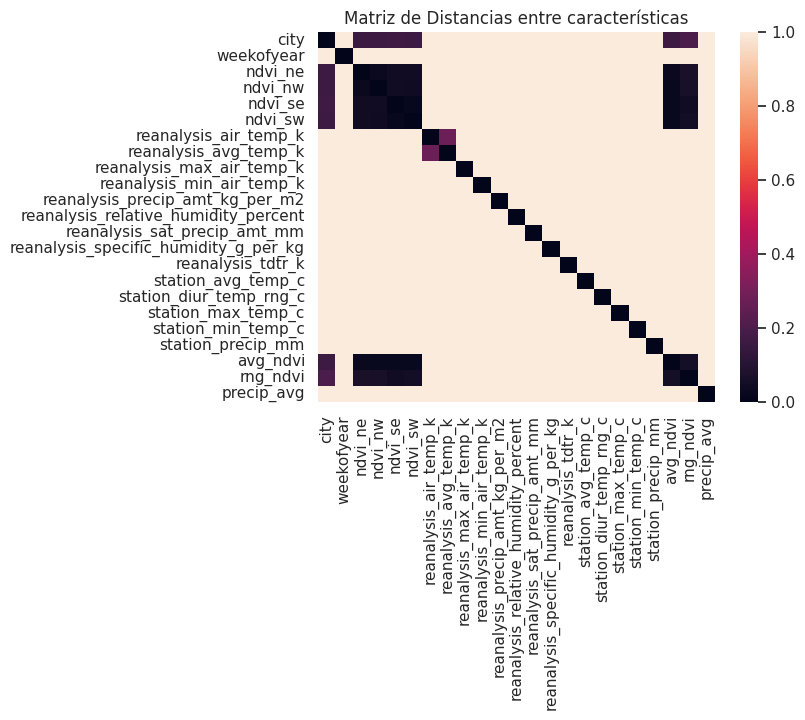

In [ ]:
# Calculo de la matriz de similitud
#http://docs.scipy.org/doc/scipy/reference/cluster.html
from scipy import cluster
import sklearn.metrics
dist = sklearn.metrics.DistanceMetric.get_metric('euclidean')
matdist= dist.pairwise(features_norm)

# Visualización de la matriz de distancias entre características
import seaborn as sns; sns.set()
ax = sns.heatmap(matdist,vmin=0, vmax=1, yticklabels = names, xticklabels = names)
plt.title("Matriz de Distancias entre características")

Al graficar la matriz de distancia podemos ver que las variables entre si no son demasiado parecidas, a excepción de las variables de vegetación y las creadas a partir de estas. Lo que indicaría que en principio formarían un clúster entre sí.

Otra manera de agrupar las características y visualizarlas es utilizar el algoritmo de clustering jerárquico con Linkage. Dependiendo de las características de los datos se puede elegir entre distintos métodos. En este caso, se usará el método promedio **(average)** porque varias características poseen outliers y es probable que tengan ruido y este método es más robusto en dichas situaciones que el método lineal (single).

<ipython-input-55-b98f95367927>:3: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  clusters = cluster.hierarchy.linkage(matdist, method = 'average')


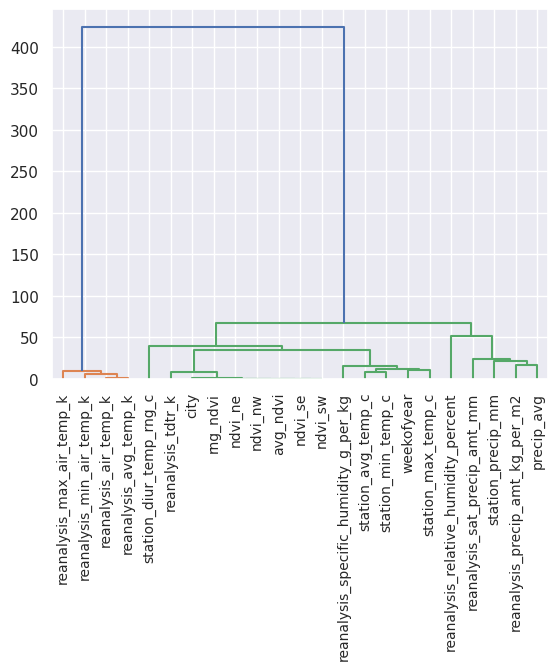

In [ ]:
# Construcción del dendograma
# http://docs.scipy.org/doc/scipy/reference/generated/scipy.cluster.hierarchy.linkage.html#scipy.cluster.hierarchy.linkage
clusters = cluster.hierarchy.linkage(matdist, method = 'average')
# http://docs.scipy.org/doc/scipy-0.14.0/reference/generated/scipy.cluster.hierarchy.dendrogram.html
cluster.hierarchy.dendrogram(clusters, color_threshold = 210, labels = names , leaf_rotation=90) #210 es el 70% de la distancia máxima
plt.show()

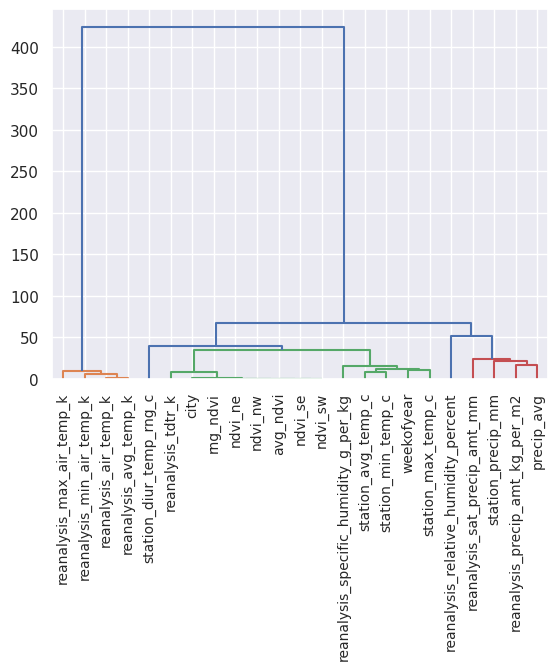

In [ ]:
cluster.hierarchy.dendrogram(clusters, color_threshold = 35, labels = names , leaf_rotation=90) #210 es el 70% de la distancia máxima
plt.show()

Se experimentó con distintos umbrales de corte que daban diferentes agrupaciones, de los cuales se muestran los dendogramas para los umbrales de 210 y 35. Se observa que si se toma el valor de 210, se forman solamente 2 clusteres. En cambio, si se toma el valor de 35 se forman 5 clusteres, donde 2 son compuestos por una única variable *'reanalysis_relative_humidity_percent' y 'station_diur_temp_rng_c'* que se interpretan como características outliers.

Utilizando Análisis de Componentes Principales (PCA) para reducir la dimensionalidad puedo visualizar esta agrupación del último dendograma en el plano (2D):

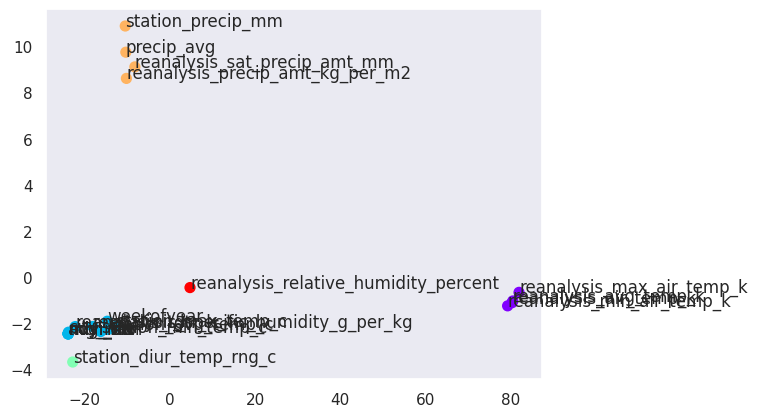

In [ ]:
# Se realiza el corte para el umbral definido
cut = 35
labels = cluster.hierarchy.fcluster(clusters, cut , criterion = 'distance')

#plotting orginal points with color related to label
plt.scatter(X_pca[:,0], X_pca[:,1], c=labels,s=50, cmap="rainbow")
for i in range(len(X_pca)):
    plt.text(X_pca[i][0], X_pca[i][1], names[i])

plt.grid()
plt.show()

Se visualizan claramente los distintos clusteres obtenidos en el algoritmo jerárquico, comprobándose que *'reanalysis_relative_humidity_percent' y 'station_diur_temp_rng_c'* son características outliers. Por lo tanto, son difíciles de reemplazar en el análisis a diferencia de los clusteres que tienen varias características, de las cuales algunas sean más representativas que otras.

### DBSCAN

Puede utilizarse para identificar características outliers o para seleccionar características relevantes basándose en la densidad de los datos.

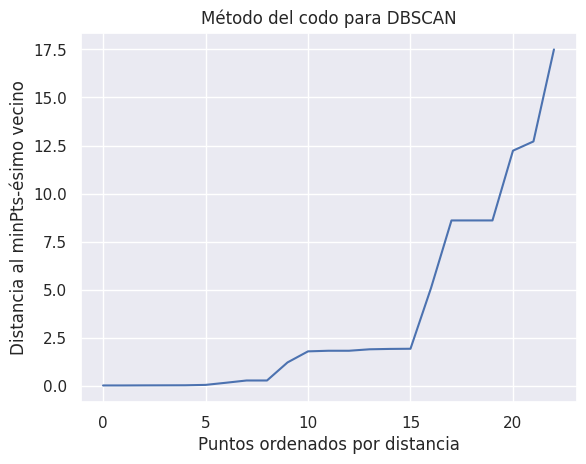

 10.00, 3, 3
 10.50, 3, 3
 11.00, 3, 3
 11.50, 3, 3
 12.00, 3, 3
 12.50, 3, 2
 13.00, 2, 1
 13.50, 2, 1
 14.00, 2, 1
 14.50, 2, 1
 15.00, 2, 1
 15.50, 2, 1
 16.00, 2, 1
 16.50, 2, 1
 17.00, 2, 1
 17.50, 2, 0
 18.00, 2, 0
 18.50, 2, 0
 19.00, 2, 0
 19.50, 2, 0


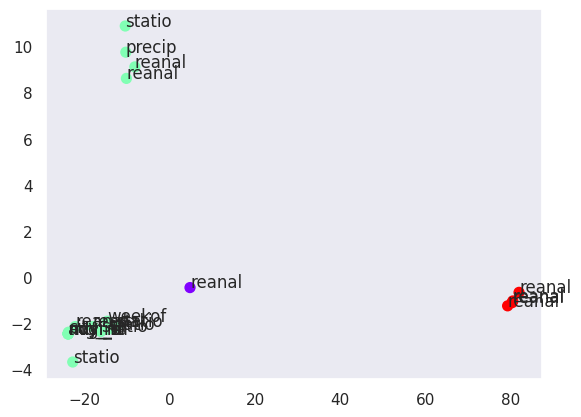

,0,1,2,3,4,5,6,7,8,9,...,1447,1448,1449,1450,1451,1452,1453,1454,1455,dbscan_group
reanalysis_relative_humidity_percent,73.365714,77.368571,82.052857,80.337143,80.46,79.891429,82.0,83.375714,82.768571,81.281429,...,87.657143,96.712857,97.445714,78.998571,88.765714,91.6,94.28,94.66,89.082857,-1


In [ ]:
# Definimos el valor de minPts
minPts = 2

# Calculamos la matriz de distancias utilizando NearestNeighbors para encontrar los vecinos más cercanos para cada punto.
neighbors = NearestNeighbors(n_neighbors=minPts)
neighbors_fit = neighbors.fit(features_norm)
distances, indices = neighbors_fit.kneighbors(features_norm)
names=df_feat.index

# Ordenamos las distancias y las graficamos para determinar el valor de eps.
distances = np.sort(distances, axis=0)
distances = distances[:, 1]  # Tomamos la distancia al minPts-ésimo vecino más cercano
plt.plot(distances)
plt.xlabel("Puntos ordenados por distancia")
plt.ylabel("Distancia al minPts-ésimo vecino")
plt.title("Método del codo para DBSCAN")
plt.show()

# Observamos el gráfico anterior y seleccionamos un rango de valores para eps
for eps in np.arange(10, 20, 0.5):
  db = DBSCAN(eps, min_samples=minPts).fit(features_norm)
  core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
  core_samples_mask[db.core_sample_indices_] = True
  labels = db.labels_
  n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
  n_outliers = list(labels).count(-1)
  print ("%6.2f, %d, %d" % (eps, n_clusters_, n_outliers))

# Seleccionamos eps y aplicamos DBSCAN
db = DBSCAN(eps=13, min_samples=minPts).fit(features_norm)
labels = db.labels_
labels

# Usamos PCA para visualizar los resultados
plt.scatter(X_pca[:,0], X_pca[:,1], c=labels,s=50, cmap="rainbow")
for i in range(len(X_pca)):
  plt.text(X_pca[i][0], X_pca[i][1], names[i][0:6])
plt.grid()
plt.show()

# Identificamos los elementos que son outliers
df_feat['dbscan_group'] = labels
df_feat[df_feat['dbscan_group'] == -1]

Al observar los gráficos de PCA en dos dimensiones con los resultados de DBSCAN, parece haber sido útil su aplicación para encontrar patrones entre las variables del dataset traspuesto, destacando relaciones de similitud entre ellas y permitiendo identificar variables únicas o posiblemente atípicas.
Las agrupaciones que se observan sugieren que se podría segmentar las variables por funcionalidad, dividiéndolas en componentes climáticos, precipitación, etc. Los clústeres separados podrían representar diferentes tipos de variables que reaccionan de forma distinta a condiciones externas, como la variabilidad estacional o climática.

Es de destacar, que se comprueba que efectivamente la característica *'reanalysis_relative_humidity_percent'* es un outlier, como se sugería en otros experimentos anteriores realizados.

En este punto se puede dar por concluída la sección de ingeniería avanzada de características.

---
# Clustering
---

### Estandarización/Normalización de los datos

Como se realizó anteriormente con el dataset traspuesto, se requiere realizar una transformación de los datos para que las distribuciones del conjunto de datos sea normal y ajustar los datos a una escala similar. Se disponen de dos técnicas: normalización y estandarización. No se realizan ambas técnicas al mismo tiempo, se elige una basada en el algoritmo a utilizar y la naturaleza de los datos.
En el EDA realizado, se observó que las mayoría de las variables siguen una distribución aproximadamente normal, aunque en algunos casos muy sesgados, por lo que conviene utilizar una estandarización para preparar los datos para los algoritmos de clustering. Además, este método ayudará a reducir el impacto de los outliers que no eliminé en el análisis y su cpacidad para mejorar el rendimiento del modelo.

Para ello aplicaré el método StandardScaler() de sklearn:

In [ ]:
# Estandarizamos los datos
train_std = StandardScaler().fit_transform(train_prepro.drop(['city', 'weekofyear'], axis=1))

Iniciare la experimentación de clustering sobre el dataset preprocesado y estandarizado con el algoritmo de K-Means, basado en particiones:

## K-Means

Inicialmente no se sabe el número de clusters que compone el dataset, por lo que primero se analizará variando la cantidad de clusteres y comparando dos métricas de que tan bueno es el clúster o agrupamiento: distorsión y silueta.

La métrica de **distorsión** mide la suma de las distancias cuadradas entre cada punto de datos y el centroide de su cluster. En otras palabras, cuantifica la dispersión de los puntos dentro de cada cluster. Un valor de distorsión más bajo indica una mejor agrupación, ya que significa que los puntos están más cerca de sus respectivos centroides

La puntuación de **silueta** mide qué tan similar es un punto de datos a su propio cluster en comparación con otros clusters. Varía de -1 a +1, donde los valores más altos indican una mejor agrupación.

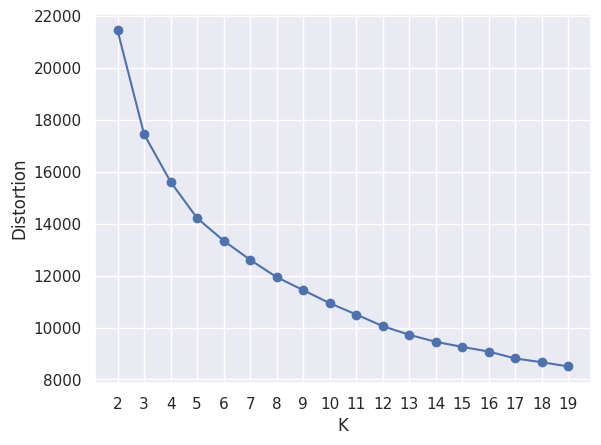

In [ ]:
distortions = []
silhouettes = []

for i in range(2, 20):
    km = KMeans(i, init='k-means++', n_init=10, max_iter=300, tol=1e-4, random_state=seed)
    clustering = km.fit_predict(train_std)
    distortions.append(km.inertia_)
    silhouettes.append(metrics.silhouette_score(train_std, clustering))

plt.plot(range(2,20), distortions, marker='o')
plt.xticks(range(2, 20))
plt.xlabel('K')
plt.ylabel('Distortion')
plt.grid(True)
plt.show()

Se observa que la distorsión tiende a disminuir a medida que se aumenta el número de clusters y a priori un valor de distorsión bajo indica una mejor agrupación. Sin embargo, puede disminuir hasta el valor de cero si cada dato se considera que consituye un clúster. Es por ello que conviene indicar un número óptimo de clusters utilizando el **Método del codo**, que busca el punto de inflexión en la curva de distorsión. Para esto se utilizará el siguiente método visto en clases:

In [ ]:
# "Satopää et al.: Finding a “Kneedle” in a Haystack: Detecting Knee Points in System Behavior"
!pip install kneed
import kneed
from kneed import KneeLocator

Elbow:  6


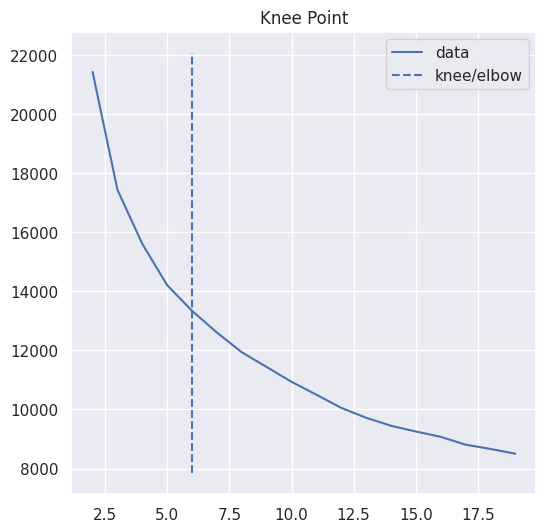

In [ ]:
# Encontrar el punto de inflexión
kneedle = KneeLocator(range(2, 20), distortions[:20], curve='convex', direction='decreasing')
elbow_point = kneedle.elbow
print('Elbow: ', elbow_point)
kneedle.plot_knee()

Según el método del codo aplicado, la mejor agrupación de de los datos sería en 6 clusteres.
Entonces, ahora se visualizará la métrica de silueta para ver que nueva información nos revela.

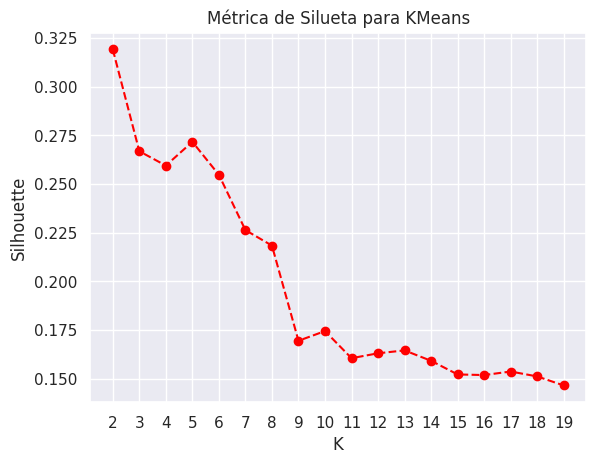

Silhouette:
[0.32, 0.27, 0.26, 0.27, 0.25, 0.23, 0.22, 0.17, 0.17, 0.16, 0.16, 0.16, 0.16, 0.15, 0.15, 0.15, 0.15, 0.15]


In [ ]:
plt.plot(range(2,20), silhouettes , marker='o', linestyle='--', color='red')
plt.xticks(range(2, 20))
plt.title("Métrica de Silueta para KMeans")
plt.xlabel('K')
plt.ylabel('Silhouette')
plt.grid(True)
plt.show()

# Métricas de silueta por K
print("Silhouette:")
print([round(silhouette, 2) for silhouette in silhouettes])

El gráfico nos permite analizar cómo cambia el Silhouette a medida que aumentamos el número de clusters. En general, se busca el valor de K que maximice el Silhouette, ya que esto indica una mejor agrupación de los datos.

En este caso, podemos observar que el Silhouette disminuye a medida que aumentamos el número de clusters. Esto sugiere que, en general, aumentar el número de clusters no mejora la calidad de la agrupación. También muestra que existe un valor de Silhouette relativamente alto para K=2. A partir de K=3, el Silhouette disminuye de forma constante. Esto sugiere que K=2 podría ser un valor óptimo para este conjunto de datos, ya que representa un equilibrio entre un Silhouette alto y un número de clusters bajo. Sin embargo, esto contradice a lo resultante del Método del codo, aunque el codo no es muy pronunciado.

Para aclarar más esta discrepancia es conveniente visualizar los clusteres hallados (2 y 6) utilizando PCA en 2D:

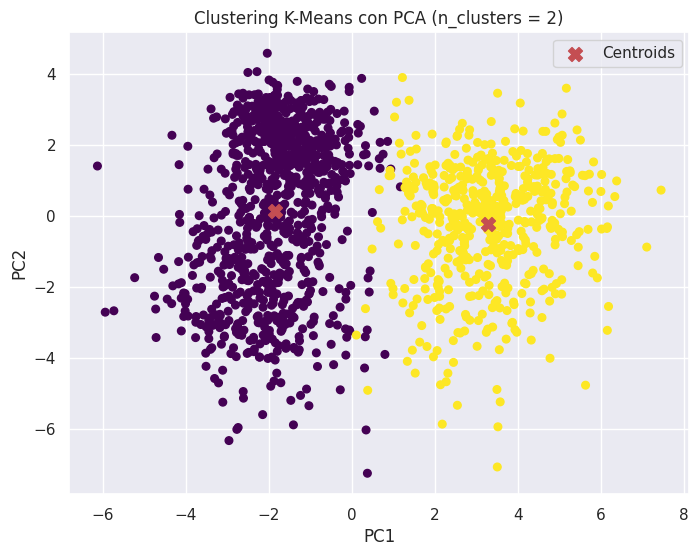

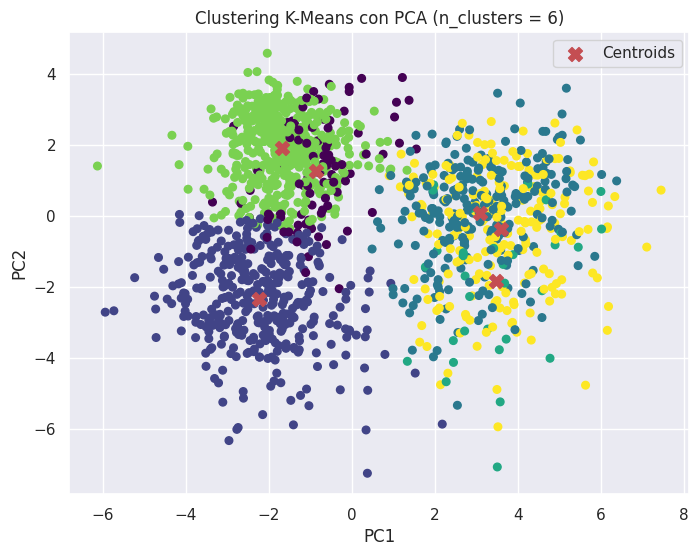

In [ ]:
# Visualización de K-Means con PCA para n clusteres
def viz_kmeans_pca(data, n_clusters_list):
    pca = PCA(n_components=2)
    data_pca = pca.fit_transform(data)

    for n_clusters in n_clusters_list:
        kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init=10, max_iter=300, random_state=seed)
        cluster_labels = kmeans.fit_predict(data)

        plt.figure(figsize=(8, 6))
        plt.scatter(data_pca[:, 0], data_pca[:, 1], c=cluster_labels, cmap='viridis', s=30)

        # Plot centroids
        centroids_pca = pca.transform(kmeans.cluster_centers_)
        plt.scatter(centroids_pca[:, 0], centroids_pca[:, 1], marker='X', s=100, color='r', label='Centroids')

        plt.xlabel('PC1')
        plt.ylabel('PC2')
        plt.title(f'Clustering K-Means con PCA (n_clusters = {n_clusters})')
        plt.legend()
        plt.show()

viz_kmeans_pca(train_std, [2, 6])

# Referencias: https://github.com/lakithasahan/Data-Anormaly-Detection, https://github.com/fariha23/recommendation_system_creditcard

De la visualización en 2D con PCA pareciera que tiene más sentido la agrupación en 2 clusteres que en 6.

## Clustering jerárquico aglomerativo

En la sección de características se realizó el clustering jerárquico pero para el dataset traspuesto, ahora se realizará para el dataset preprocesado y estandarizado.

En este caso se utiliza el método **'ward'**, cuyo objetivo es minimizar la varianza dentro de los clústeres, y es una buena opción para que sea menos sensible a los valores atípicos que tiene nuestro dataset. Además, se ha experimentado con 'single' y 'average' y los resultados de 'ward' han sido mejores en función del conocimiento del dominio.

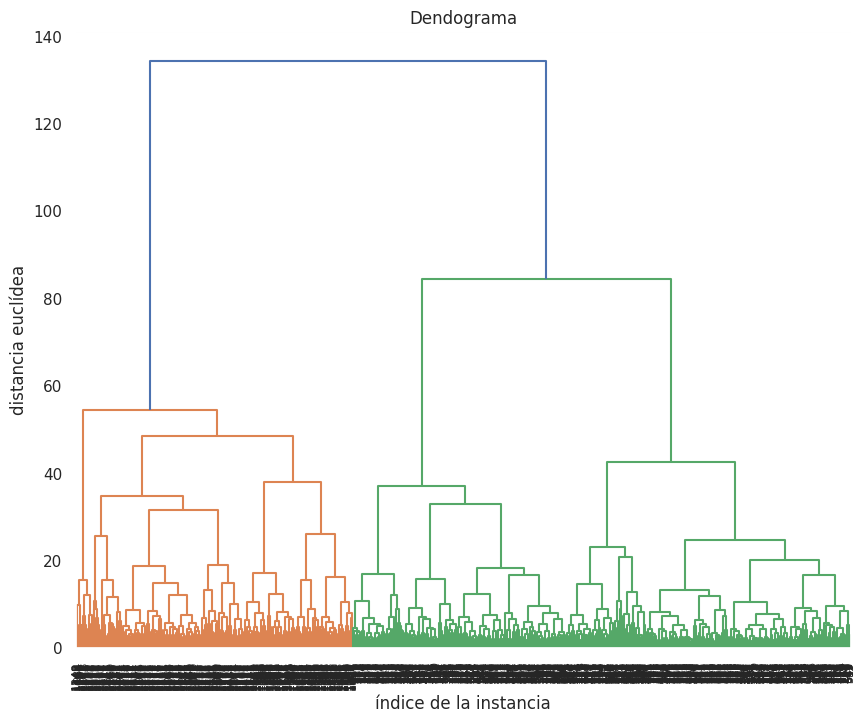

In [ ]:
# Clustering jerárquico
plt.figure(figsize=(10, 8))
plt.title("Dendograma")
plt.xlabel('índice de la instancia')
plt.ylabel('distancia euclídea')
Z = linkage(train_std, method='ward', metric='euclidean')
dendrogram(
    Z,
    leaf_rotation=90.,
    leaf_font_size=8.,
)
plt.show()

In [ ]:
from scipy.cluster.hierarchy import cophenet
from scipy.spatial.distance import pdist

# pdist calcula las distancias entre elementos de nuestro dataset usando la
# métrica indicada (euclideana por defecto)
c, coph_dists = cophenet(Z, pdist(train_std))
c

0.6182010449940186

Se calculó el coeficiente de correlación cofenética, para ver que tan bien generado está el dendograma a partir del clustering jerárquico, ya que reflejas las distancias originales entre los puntos de datos. Este coeficiente varía entre 0 y 1, por lo que valores altos indican un mayor ajuste entre el dendograma y la estrucutra de los datos. En este caso el coeficiente es de 0.62, un valor alto pero no mucho.

Si cortamos el dendograma donde tenemos las líneas más altas vemos que tenemos dos clústers claramente formados. A continuación lo simplificamos para visualizar mejor las instancias.

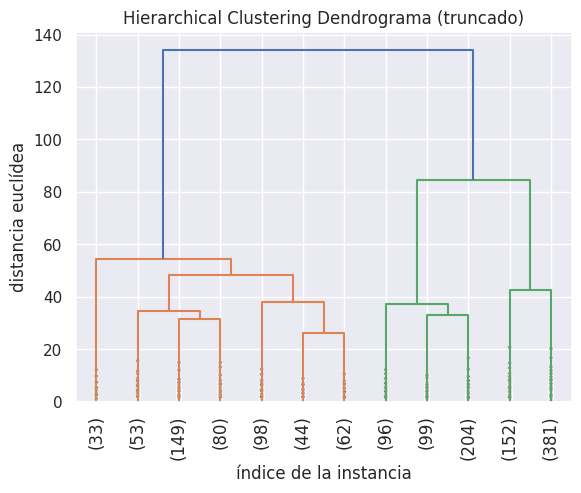

In [ ]:
# Nos quedamos con las últimas p
plt.title('Hierarchical Clustering Dendrograma (truncado)')
plt.xlabel('índice de la instancia')
plt.ylabel('distancia euclídea')
dendrogram(
    Z,
    truncate_mode='lastp',  # mostrar solo las últimas p uniones
    p=12,  # definimos p
    leaf_rotation=90.,
    leaf_font_size=12.,
    show_contracted=True,
)
plt.show()

Cortando en 60 para el cluster de la derecha con mayor distancia vertical, se encuentra que hay 3 grupos de instancias bien diferenciados.

Otra visualización que puede sernos útil:

/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


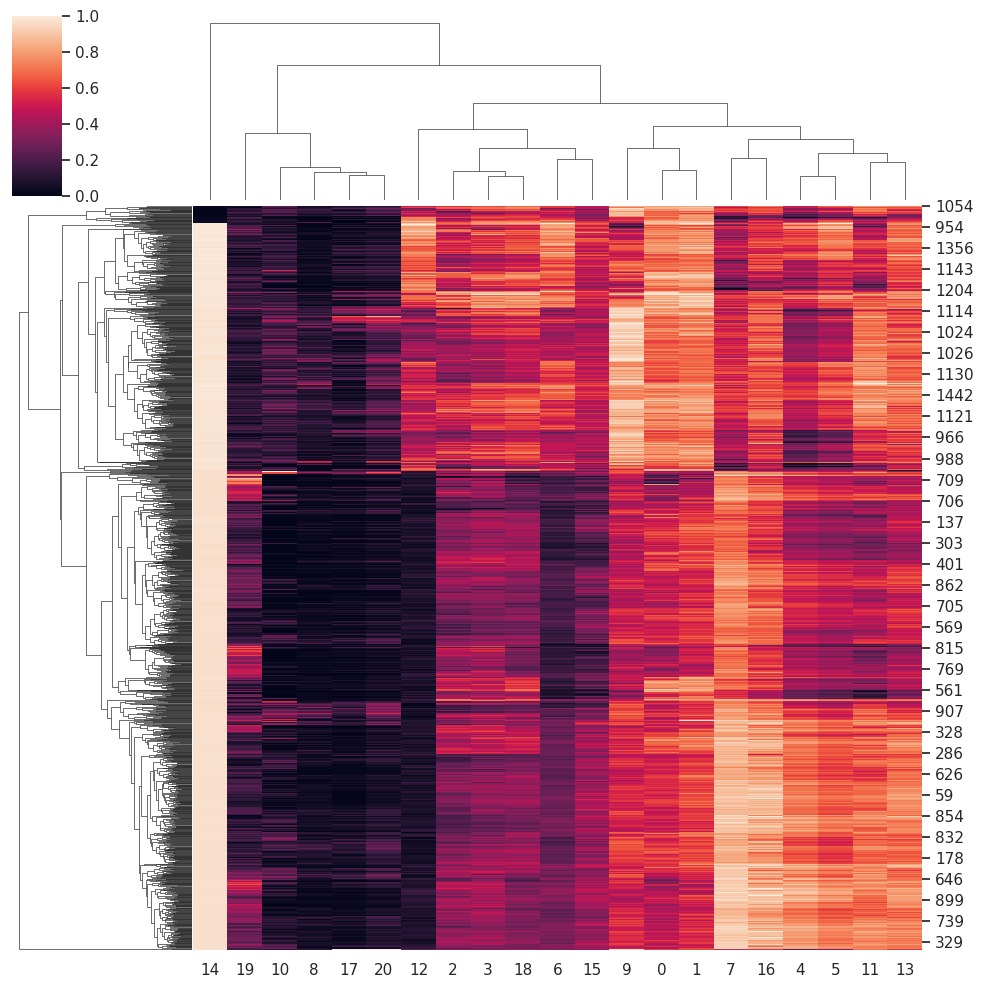

In [ ]:
import seaborn as sns
sns.set(color_codes=True)
sns.clustermap(train_std, standard_scale=1)

Observando el dendograma superior del clustermap se pueden identificar subgrupos de carcaterísticas que tienen relaciones similares entre sí. Por ejemplo, varias de las relacionadas con la temperatura están agrupadas juntas, sugiriendo que tienen comportamientos similares. Se puede ver que las variables de humedad se agrupan con la temperatura, lo que sugiere una fuerte dependencia entre ellas. Esto tiene sentido, ya que temperaturas más altas pueden aumentar la evaporación y afectar la humedad en el ambiente. Por otro lado, la lluvia medida en estaciones meteorológicas y los datos de reanálisis están muy correlacionados. Finalmente, los valores del índice de vegetación normalizado 'ndvi' están agrupados, lo que confirma que estas mediciones están altamente relacionadas entre sí en diferentes regiones geográficas.

En la matriz de calor se observa una clara diferencia entre columnas con valores altamente variables y otras con valores más constantes. Por ejemplo, la variable *'station_precip_mm'* parece tener muchos valores bajos (oscuros), mientras que *'reanalysis_specific_humidity_g_per_kg'* o *'station_diur_temp_rng_c'*, en el caso más extremo, tienen una distribución más homogénea. Esto indica que variables como temperatura y humedad muestran transiciones graduales en la intensidad del color, lo que sugiere un comportamiento continuo en el tiempo, mientras que precipitación y 'ndvi' muestran patrones más segmentados, lo que podría indicar eventos climáticos más esporádicos.

En el dendograma izquierdo de las instancias y considerando el mapa de calor, se puede notar zonas con patrones similares, lo que sugiere que ciertos grupos de intancias o registros comparten características ambientales similares.

In [ ]:
cluster = AgglomerativeClustering(n_clusters=3, metric='euclidean', linkage='ward') # entre 2 y 4
clusters = cluster.fit_predict(train_std)
print(clusters)
#plt.figure(figsize=(10, 7))
#plt.scatter(train_std[:,0], train_std[:,1], c=cluster.labels_, cmap='rainbow')

[2 2 2 ... 0 0 0]


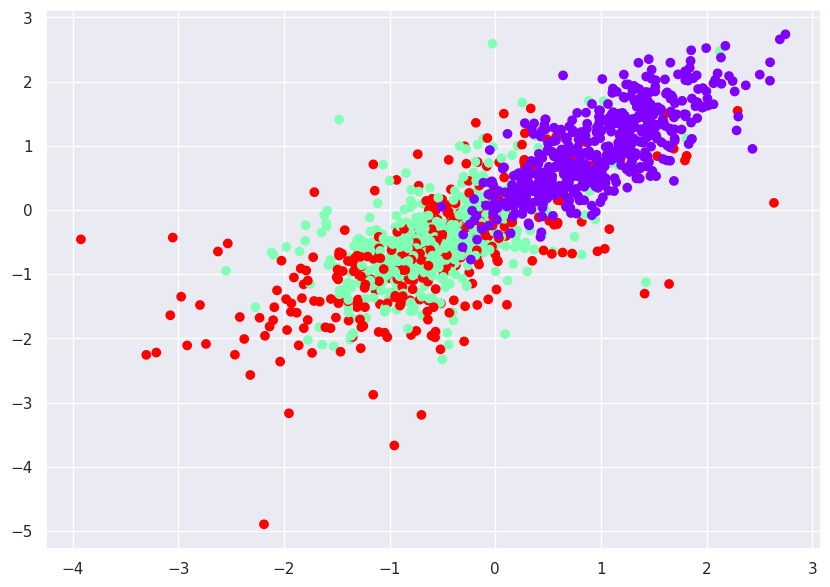

In [ ]:
plt.figure(figsize=(10, 7))
plt.scatter(train_std[:,0], train_std[:,1], c=cluster.labels_, cmap='rainbow')

La visualización anterior es poco clara. Entonces, para determinar cuántos clusters son óptimos de manera más objetiva, se recurre a la ayuda de la **métrica de silueta**.

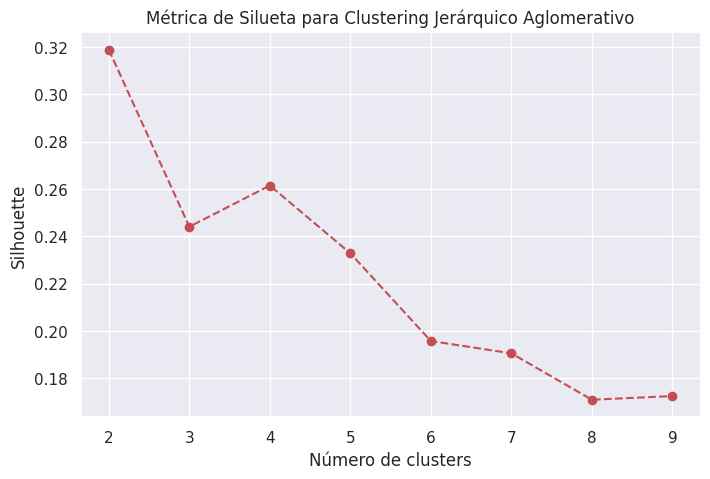

El número de clusters óptimo según la silueta es: 2
Silhouette:
[0.32, 0.27, 0.26, 0.27, 0.25, 0.23, 0.22, 0.17, 0.17, 0.16, 0.16, 0.16, 0.16, 0.15, 0.15, 0.15, 0.15, 0.15]


In [ ]:
# Aplico clustering jerárquico sin definir clusters
Z = linkage(train_std, method='ward', metric='euclidean')

# Pruebo diferentes cortes en el dendrograma
range_n_clusters = list(range(2, 10))
silueta_scores = []

for n_clusters in range_n_clusters:
    clustering = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    labels = clustering.fit_predict(train_std)
    score = silhouette_score(train_std, labels)
    silueta_scores.append(score)

# Grafico la silueta para elegir el número de clusters óptimo
plt.figure(figsize=(8, 5))
plt.plot(range_n_clusters, silueta_scores, marker='o', linestyle='--', color='r')
plt.xlabel('Número de clusters')
plt.ylabel('Silhouette')
plt.title('Métrica de Silueta para Clustering Jerárquico Aglomerativo')
plt.show()

# Mejor número de clusters basado en la silueta
best_n_clusters = range_n_clusters[np.argmax(silueta_scores)]
print(f"El número de clusters óptimo según la silueta es: {best_n_clusters}")

# Métricas de silueta por nro. de clusteres
print("Silhouette:")
print([round(silhouette, 2) for silhouette in silhouettes])


Se observa que el coeficiente de Silhouette tiende a disminuir a medida que aumentamos el número de clusters, lo cual es un comportamiento común en muchos conjuntos de datos. El valor más alto obtenido es 0.32 para 2 clusters, lo que sugiere una separación deficiente entre los grupos y posibles asignaciones incorrectas. Esto indica que el Agglomerative Clustering no está generando clusters bien definidos en este caso y podría ser recomendable explorar otros métodos de clustering o ajustar los parámetros utilizados.

## DBSCAN

DBSCAN (Density-Based Spatial Clustering of Applications with Noise) es un método de clustering basado en densidad de puntos. Agrupa puntos densamente conectados y considera los puntos aislados como outliers. Tiene dos parámetros clave:

*  'eps': radio de vecindad para considerar un punto "cercano".
*  'minpts'(o 'minsamples'): número mínimo de puntos para formar un cluster.

Como en el caso de KMeans, primero se analizará variando el número de clusteres como afecta a la  métrica de la silueta:





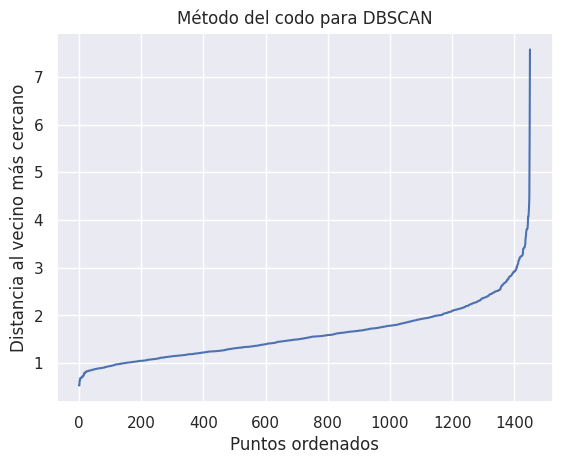

In [ ]:
def find_optimal_eps(X):
    neighbors = NearestNeighbors(n_neighbors=2)
    neighbors_fit = neighbors.fit(X)
    distances, _ = neighbors_fit.kneighbors(X)
    distances = np.sort(distances[:, 1])

    import matplotlib.pyplot as plt
    plt.plot(distances)
    plt.xlabel("Puntos ordenados")
    plt.ylabel("Distancia al vecino más cercano")
    plt.title("Método del codo para DBSCAN")
    plt.show()

find_optimal_eps(train_std)

Del método del codo se observa que la curva cambia en una distancia al vecino más cercano de eps=3, por lo tanto este será el valor que utilizaré para calcular los coeficientes de silueta.

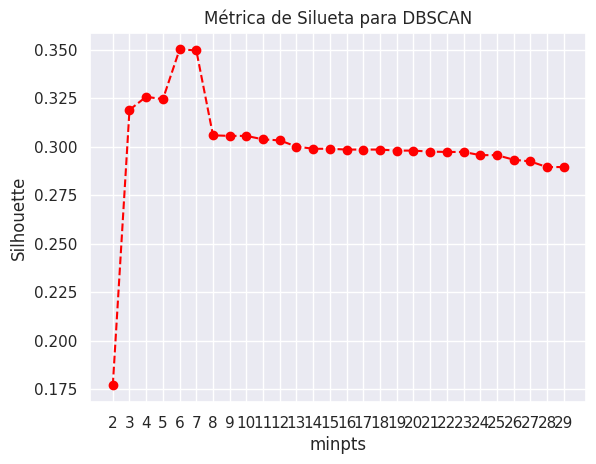

Silhouette:
[0.177, 0.319, 0.3258, 0.3245, 0.3502, 0.3497, 0.3059, 0.3056, 0.3056, 0.3038, 0.3033, 0.3001, 0.299, 0.299, 0.2986, 0.2986, 0.2986, 0.298, 0.298, 0.2975, 0.2973, 0.2973, 0.2957, 0.2957, 0.2933, 0.2925, 0.2895, 0.2896]


In [ ]:
silhouettes = []

for i in range(2, 30):
    dbscan = DBSCAN(eps=3, min_samples= i)
    clustering = dbscan.fit_predict(train_std)
    silhouettes.append(metrics.silhouette_score(train_std, clustering))

plt.plot(range(2,30), silhouettes , marker='o', linestyle='--', color='red')
plt.xticks(range(2, 30))
plt.title("Métrica de Silueta para DBSCAN")
plt.xlabel('minpts')
plt.ylabel('Silhouette')
plt.grid(True)
plt.show()

# Métricas de silueta por K
print("Silhouette:")
print([round(silhouette, 4) for silhouette in silhouettes])

Se observa que para un valor de eps=3, la mejor métrica de silueta se encuentra para minpts=6, con un valor algo bajo de 0.3502. Por lo tanto, vemos el número de clusters formados con estos parámetros:

In [ ]:
dbscan = DBSCAN(eps=3, min_samples = 6)
clusters = dbscan.fit_predict(train_std)
np.unique(clusters)

array([-1,  0])

Es decir, que hay un cluster (0) y ruido (-1). Lo represento en 2D para visualizar si esto es acertado:

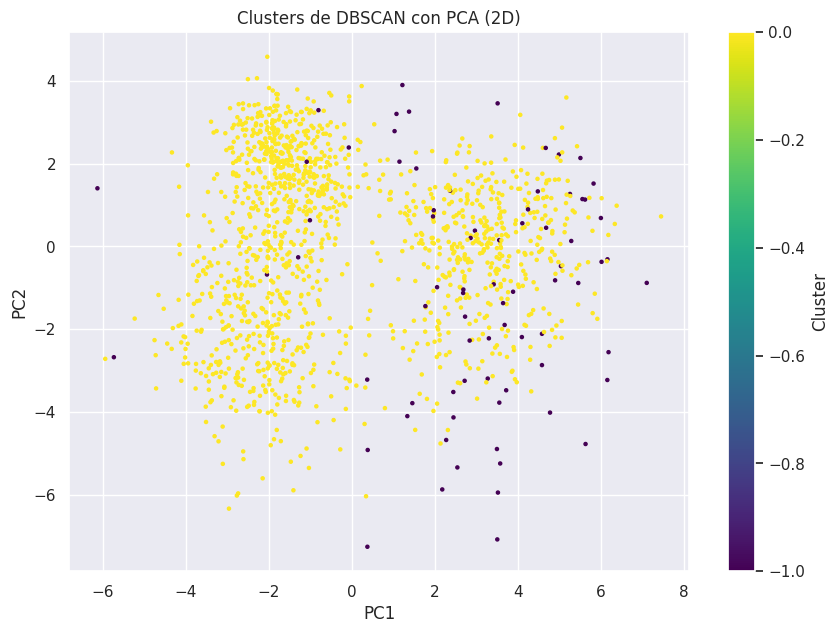

In [ ]:
# PCA para visualización
pca = PCA(n_components=2)
train_pca = pca.fit_transform(train_std)

# Graficar clusters
plt.figure(figsize=(10, 7))
plt.scatter(train_pca[:, 0], train_pca[:, 1], c=clusters, cmap='viridis', s=5)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Clusters de DBSCAN con PCA (2D)")
plt.colorbar(label="Cluster")
plt.show()

Por la forma de los datos, diera la impresión de que hay más de un cluster. Sin embargo, hay que tener presente que lo que representa el gráfico es una proyección de muchas dimensiones a 2. Por todo lo anterior, se buscarán los parámetros que optimizan la métrica de la silueta con DBSCAN:

In [ ]:
def find_best_dbscan_params(X, eps_range, min_samples_range):
    """
    Encuentra los mejores parámetros (eps y min_samples) para DBSCAN optimizando el coeficiente de silueta.

    Args:
        X: Los datos para el clustering.
        eps_range: Una lista o tupla con los valores de eps a probar.
        min_samples_range: Una lista o tupla con los valores de min_samples a probar.

    Returns:
        Una tupla con:
            - El mejor valor de eps.
            - El mejor valor de min_samples.
            - El mejor coeficiente de silueta.
    """
    best_eps = None
    best_min_samples = None
    best_silhouette = -1  # Inicializamos con un valor bajo

    for eps in eps_range:
        for min_samples in min_samples_range:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(X)

            # Ignorar los casos donde solo hay un cluster o todos los puntos son ruido
            if len(set(labels)) > 1 and np.any(labels != -1):
                silhouette = silhouette_score(X, labels)
                if silhouette > best_silhouette:
                    best_silhouette = silhouette
                    best_eps = eps
                    best_min_samples = min_samples

    return best_eps, best_min_samples, best_silhouette

find_best_dbscan_params(train_std, np.arange(0.5, 20, 0.5), range(2,40))

# Referencia: https://github.com/tenyearstranger/DM_h y Gemini

(7.0, 2, 0.5950047264446199)

Se obtiene que los mejores parámetros son eps=7 y min_samples=2, para un valor de silueta de 0.595.

In [ ]:
dbscan = DBSCAN(eps=7, min_samples = 2)
clusters = dbscan.fit_predict(train_std)
np.unique(clusters)

array([-1,  0])

Se obtiene el mismo resultado, por lo que a priori no pareciera ser un método aceptable para clustering de mi dataset.

## Expectation - Maximization aplicado a Gaussian Mixture Models (GMM)

El método de clustering Expectation-Maximization (EM) aplicado a Gaussian Mixture Models (GMM) es una técnica probabilística que agrupa datos asumiendo que cada cluster sigue una distribución gaussiana (normal). A diferencia de K-Means, donde cada punto pertenece a un solo cluster, GMM asigna a cada punto una probabilidad de pertenecer a cada cluster.

Además de la métrica de la silueta, para este modelo se considerará el Criterio de Información de Akaike (AIC) que mide la cantidad de información perdida cuando se utiliza un modelo particular para representar los datos. En otras palabras, evalúa qué tan bien se ajusta un modelo a los datos y penaliza la complejidad del modelo. El AIC busca un equilibrio entre la bondad de ajuste y la simplicidad del modelo. Entonces, un valor de AIC más bajo se considera mejor.

In [ ]:
k_range = range(2, 20)
silhouettes = []
aics = []

for k in k_range:
    gmm = GaussianMixture(n_components=k, random_state=seed)
    gmm_labels = gmm.fit_predict(train_std)
    silhouette_gmm = metrics.silhouette_score(train_std, gmm_labels)
    silhouettes.append(silhouette_gmm)
    aics.append(gmm.aic(train_std))

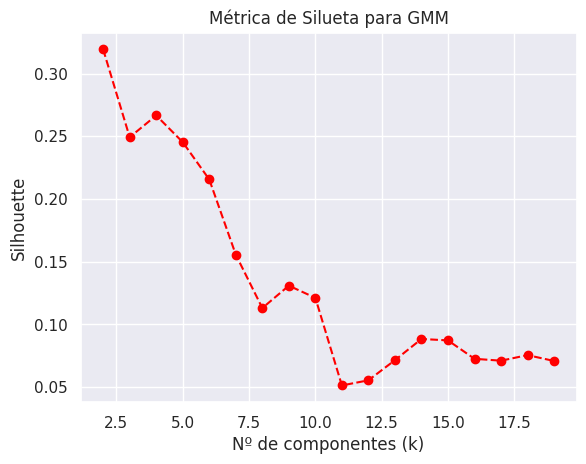

Silhouette: [0.319, 0.249, 0.267, 0.245, 0.216, 0.156, 0.113, 0.131, 0.121, 0.051, 0.055, 0.072, 0.088, 0.087, 0.073, 0.071, 0.076, 0.071]
N° de componentes óptimo = 2


In [ ]:
# Gráfico métrica de silueta
plt.figure()
plt.plot(k_range, silhouettes, marker='o', linestyle='--', color='red')
plt.title("Métrica de Silueta para GMM")
plt.xlabel("Nº de componentes (k)")
plt.ylabel("Silhouette")
plt.grid(True)
plt.show()

print("Silhouette:", [round(s,3) for s in silhouettes])

best_k_sil = k_range[np.argmax(silhouettes)]
print("N° de componentes óptimo =", best_k_sil)

Se observa que el mejor valor de silueta se obtiene para k=2, con un valor bajo de 0.319. Para visualizar GMM con este parámetro se grafica en 2D utilizando PCA:

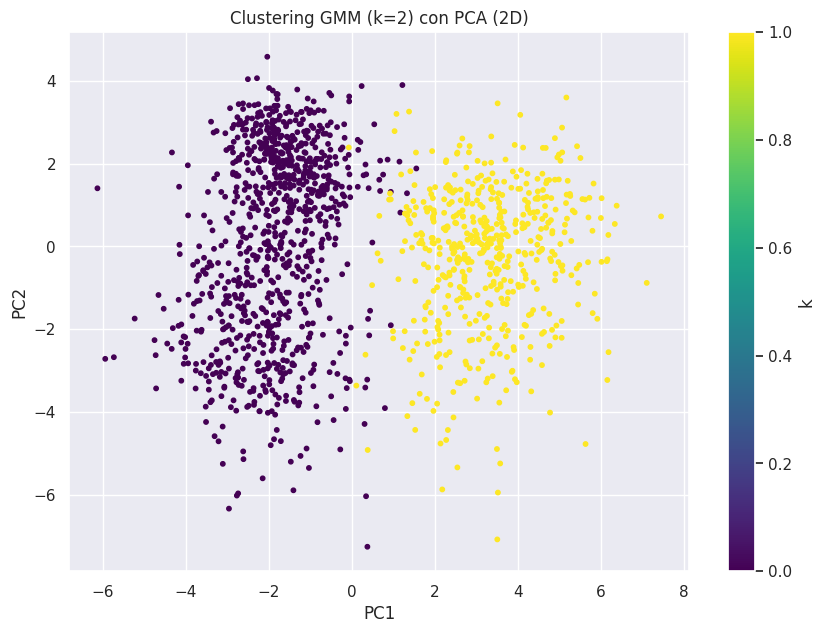

In [ ]:
# Visualizamos con el mejor k según Silueta
gmm_final = GaussianMixture(n_components=best_k_sil, random_state=seed)
labels_gmm = gmm_final.fit_predict(train_std)

# PCA para visualización
pca = PCA(n_components=2)
train_pca = pca.fit_transform(train_std)

# Graficar clusters
plt.figure(figsize=(10, 7))
plt.scatter(train_pca[:, 0], train_pca[:, 1], c=labels_gmm, cmap='viridis', s=10)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title(f"Clustering GMM (k={best_k_sil}) con PCA (2D)")
plt.colorbar(label="k")
plt.show()

Como es un algoritmo probabilístico, se calcula la probabilidad de que cada uno de los primeros 20 datos pertenezca a uno de los dos clusters obtenidos:

In [ ]:
probabilities = gmm_final.predict_proba(train_std)
probabilities[:20]

array([[1.00000000e+00, 1.68041015e-33],
       [1.00000000e+00, 9.40548469e-27],
       [1.00000000e+00, 6.13155564e-25],
       [1.00000000e+00, 2.11710360e-25],
       [1.00000000e+00, 1.90937644e-20],
       [1.00000000e+00, 6.75221689e-23],
       [1.00000000e+00, 1.85274592e-24],
       [1.00000000e+00, 1.67994056e-18],
       [1.00000000e+00, 6.80114646e-21],
       [1.00000000e+00, 3.87720647e-24],
       [1.00000000e+00, 5.41380610e-22],
       [1.00000000e+00, 3.59747012e-20],
       [1.00000000e+00, 1.57296959e-23],
       [1.00000000e+00, 3.66489151e-27],
       [1.00000000e+00, 2.16102575e-26],
       [1.00000000e+00, 7.88918355e-18],
       [1.00000000e+00, 8.67361800e-24],
       [1.00000000e+00, 5.85920833e-24],
       [1.00000000e+00, 2.90631929e-21],
       [1.00000000e+00, 8.26051175e-35]])

In [ ]:
np.unique(probabilities)

array([0.00000000e+000, 2.00247896e-302, 7.98576139e-301, ...,
       1.00000000e+000, 1.00000000e+000, 1.00000000e+000])

Se observa que hay distintos valores de probabilidades, con lo cual no es claro que la cantidad de clusteres óptimos sean k=2. Por ello se visualiza la otra métrica, para ver que nueva información nos da:

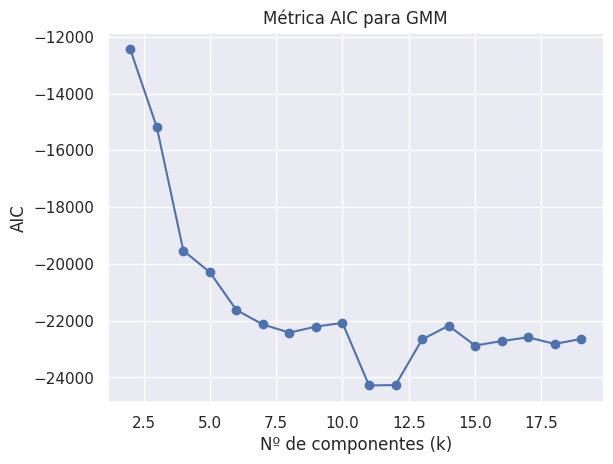

N° AIC óptimo = 11


In [ ]:
# Gráfico métrica de AIC
plt.figure()
plt.plot(k_range, aics, marker='o', color='b')
plt.title("Métrica AIC para GMM")
plt.xlabel("Nº de componentes (k)")
plt.ylabel("AIC")
plt.grid(True)
plt.show()

best_k_aic = k_range[np.argmin(aics)]
print("N° AIC óptimo =", best_k_aic)

La gráfica de AIC para GMM muestra que el criterio disminuye rápidamente hasta  k=10, indicando que aumentar los componentes mejora el modelo hasta ese punto. A partir de k=12, AIC se estabiliza y fluctúa levemente, sugiriendo que más clusters no aportan mejoras significativas y pueden generar sobreajuste. Por lo tanto, k=11 parece ser el número óptimo de clusters según AIC. Este resultado contrasta con el análisis de Silueta, donde k=2 parecía óptimo. En este caso, la silueta sugiere que un número menor de clusters (posiblemente entre 2 y 5) podría ser más adecuado para una mejor separación de los datos.

Visualizamos los clusteres obtenidos con la optimización de AIC:









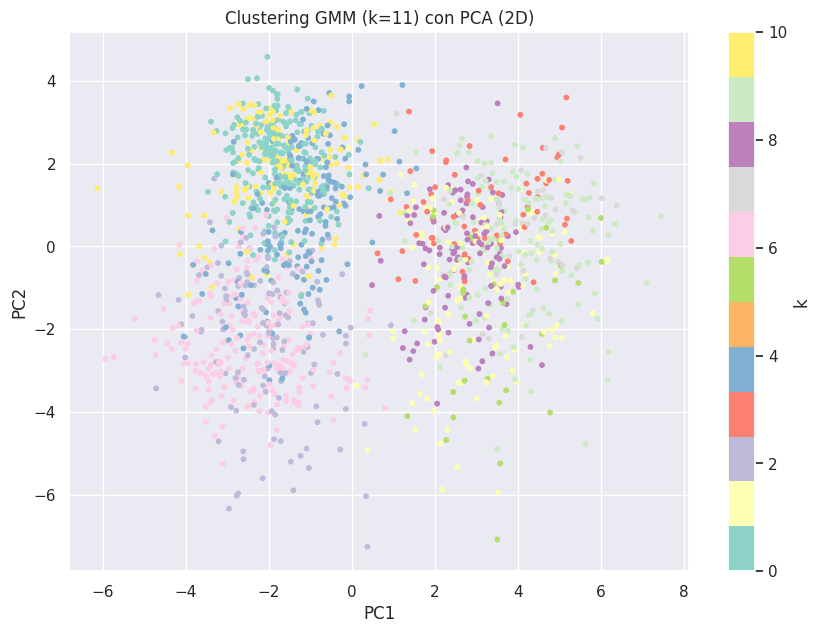

In [ ]:
# Visualizamos con el mejor k según AIC
gmm_final = GaussianMixture(n_components=best_k_aic, random_state=seed)
labels_gmm = gmm_final.fit_predict(train_std)

# PCA para visualización
pca = PCA(n_components=2)
train_pca = pca.fit_transform(train_std)

# Graficar clusters
plt.figure(figsize=(10, 7))
plt.scatter(train_pca[:, 0], train_pca[:, 1], c=labels_gmm, cmap='Set3', s=10)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title(f"Clustering GMM (k={best_k_aic}) con PCA (2D)")
plt.colorbar(label="k")
plt.show()

La visualización no resulta clara. Entonces, ¿cuál es el número óptimo de clústeres para este método? ¿Bajo qué criterio o métrica es posible determinarlo de mejor forma? Observando las gráficas de ambas métricas se puede ver a simple vista que para un k=4 el método de silueta tiene un valor de 0.267 y el AIC cae a un valor mucho más bajo que con k=2, aunque no tanto como con k=11. Esto podría ser una buena solución de compromiso. Visualicemos el caso:

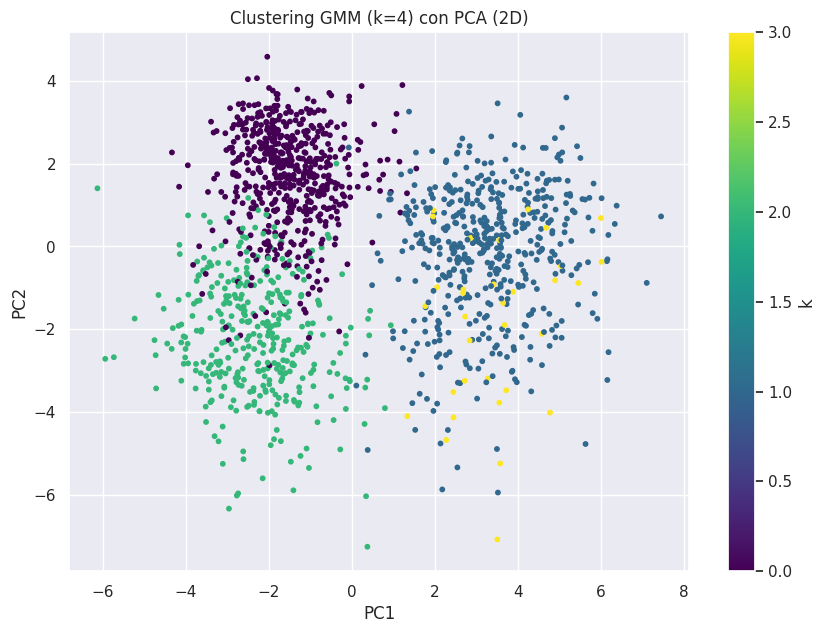

In [ ]:
gmm_final = GaussianMixture(n_components=4, random_state=seed)
labels_gmm = gmm_final.fit_predict(train_std)

# PCA para visualización
pca = PCA(n_components=2)
train_pca = pca.fit_transform(train_std)

# Graficar clusters
plt.figure(figsize=(10, 7))
plt.scatter(train_pca[:, 0], train_pca[:, 1], c=labels_gmm, cmap='viridis', s=10)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title(f"Clustering GMM (k=4) con PCA (2D)")
plt.colorbar(label="k")
plt.show()

---
# Conclusiones
---

El análisis exploratorio de datos (EDA) reveló aspectos clave que influyeron en el preprocesamiento, la ingeniería de características y la interpretación de resultados. Estos hallazgos también ofrecen dirección para futuros modelos predictivos:

*  *Desbalanceo de 'city'*: La mayor representación de San Juan requiere estrategias de remuestreo o modelos específicos para cada ciudad. Aunque no justificó transformaciones separadas del dataset, como se dedujo de su exploración por separado, su impacto en la generalización del modelo debe ser abordado.
*  *Distribución de variables*: Las distribuciones variadas (simétricas en 'ndvi', asimétricas en precipitación, más uniformes en temperatura) influyeron en el preprocesamiento y deben considerarse al seleccionar modelos.
*  *Outliers*: Los outliers, especialmente en precipitación y temperatura, fueron analizados y conservados durante el preprocesamiento ya que podrían brindar información importante sobre eventos climáticos extremos, pero su impacto en modelos futuros debe ser evaluado.
*  *Correlaciones*: Se eliminaron las variables 'precipitation_amt_mm' y 'reanalysis_dew_point_temp_k' por tener una correlación de 1 con otras variables del dataset (idénticas), a fin de evitar multicolinealidad.
*  *Variabilidad temporal*: Las diferencias temporales entre ciudades, especialmente en vegetación y amplitud térmica, resaltan la importancia de 'weekofyear' y justificaron la eliminación de 'year' y 'week_start_date'.

En el preprocesado se trataron los valores nulos eliminando algunas instancias con muy pocos datos y se imputaron los valores faltantes utilizando el conocimiento del dominio del problema extraído del EDA y el método interpolate.

Mediante ingeniería de características se generó nuevas variables (promedio y rango de NDVI, temperatura y rango de temperatura promedio, precipitación promedio), pero la alta correlación llevó a eliminar 'avg_air_temp' y 'avg_temp_diur_rng' para evitar redundancia de información. El análisis de componentes principales (PCA) y técnicas de clustering (jerárquico, DBSCAN) ayudaron a reducir ruido y redundancia, identificando a 'reanalysis_relative_humidity_percent' como una característica outlier.

El clustering se exploró con K-Means, Clustering Jerárquico, DBSCAN y EM con GMM, utilizando la métrica de silueta y, en algunos casos, distorsion o AIC para determinar el número óptimo de clusters.

En *K-Means*, apoyándose en la visualización de los clusters en 2D con PCA, se concluyó que la agrupación en **k=2** obtenida con un coeficiente de silueta relativamente bajo (0.32), parecía tener más sentido que la de k=6 identificada mediante la aplicación del método del codo a la distorsión.

En *Clustering Jerárquico Aglomerativo* el coeficiente de correlación cofenética de 0.62 indica un ajuste bastante bueno del dendograma a la estructura de datos. El coeficiente de silueta más alto (0.32) se obtuvo para **2 clusteres**, sin embargo es un valor bajo que indica una separación deficiente.

Se exploró *DBSCAN* variando los parámetros eps y minpts para optimizar el coeficiente de silueta. Se encontró un valor óptimo de 0.595 para ciertos parámetros, indicando una separación entre **1 cluster y ruido**, pero la visualización en 2D no resulta clara y se concluyó que este método podría no ser adecuado para el dataset.

Se aplicó el método probabilístico *Expectation-Maximization (EM) con GMM* para agrupar los datos asumiendo distribuciones gaussianas. Se observó que el mejor valor de silueta (0.319) se obtenía para frecuencia **k=2** de mayor separación. Mientras que con el criterio de AIC se obtenía **k=11**. Sin embargo, se obtiene una solución de compromiso viable para ambas métricas con **k=4**.

Si bien de los experimentos se observa que no hay un método de clustering claramente superior, en la mayoría **k=2** logra el mejor coeficiente de silueta (~0.32), indicando dos grandes grupos con relativa buena separación. Este valor de silueta no es muy bueno, pero las visualizaciones en 2D usando PCA sobre los datos normalizados, parecieran corroborar que 2 clústeres es lo más acertado. Sin embargo, hay que tener presente que PCA 2D no debe ser la base para decidir ya que es una proyección de altas dimensiones y que con criterios distintos a la métrica de silueta (método del codo, AIC) se pueden obtener más clústeres.

No obstante, se sugiere que la solución intermedia obtenida con GMM de **k=4** podría ser un buen número de clusters como compromiso entre las diferentes métricas evaluadas. La métrica de la silueta sólo cae 0.05 en comparación con los 0.27 que cae para k=11, pero baja en casi 8000 el valor de AIC. Por lo que casi no se sacrifica claridad en la separación en pos de un mejor ajuste a los datos y su complejidad.

Para un trabajo futuro, se recomienda realizar un análisis exhaustivo de la relación entre las variables predictoras y la cantidad de casos de dengue (variable objetivo), extendiendo el Análisis Exploratorio de Datos (EDA) en esa dirección. Además, se sugiere explorar el uso de algoritmos de clasificación para modelar la presencia o ausencia de casos de dengue, analizando las razones subyacentes a los clusters generados y etiquetando el conjunto de datos para su posterior análisis. Dada la complejidad inherente de los datos, se hace hincapié en la implementación de una estrategia de validación cruzada robusta para evaluar el rendimiento del modelo y asegurar su capacidad de generalización. Finalmente, se aconseja complementar la métrica de silueta con otras métricas de clustering, como el índice de Davies-Bouldin o la información mutua normalizada (NMI), para obtener una evaluación más completa y precisa de los resultados del clustering.